In [1]:
!pip install -r ../requirements.txt

# Imports

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os

from matplotlib import animation
from IPython import display

import torch
import torch.nn as nn
import torch.optim as optim
from torch import Tensor
from torch.utils.data import TensorDataset
from torch.utils.data import DataLoader
from torch.utils.data import DataLoader

from torchsummary import summary

from tqdm import tqdm


In [3]:
if not os.path.exists("checkpoints"):
    os.mkdir("checkpoints")

In [4]:
data_dir: str = '/media/jychpr/ADATA SD810/kaggle_data/google-research-identify-contrails-reduce-global-warming'

In [5]:
df_train_idx = pd.DataFrame({'idx': os.listdir(os.path.join(data_dir, 'train'))})
df_validation_idx = pd.DataFrame({'idx': os.listdir(os.path.join(data_dir, 'validation'))})
df_test_idx = pd.DataFrame({'idx': os.listdir(os.path.join(data_dir, 'test'))})

In [6]:
def get_band_images(idx: str, parrent_folder: str, band: str) -> np.array:
    return np.load(os.path.join(data_dir, parrent_folder, idx, f'band_{band}.npy'))

In [7]:
_T11_BOUNDS = (243, 303)
_CLOUD_TOP_TDIFF_BOUNDS = (-4, 5)
_TDIFF_BOUNDS = (-4, 2)

def normalize_range(data, bounds):
    """Maps data to the range [0, 1]."""
    return (data - bounds[0]) / (bounds[1] - bounds[0])


def get_ash_color_images(idx: str, parrent_folder: str, get_mask_frame_only=False) -> np.array:
    band11 = get_band_images(idx, parrent_folder, '11')
    band14 = get_band_images(idx, parrent_folder, '14')
    band15 = get_band_images(idx, parrent_folder, '15')
    
    if get_mask_frame_only:
        band11 = band11[:,:,4]
        band14 = band14[:,:,4]
        band15 = band15[:,:,4]

    r = normalize_range(band15 - band14, _TDIFF_BOUNDS)
    g = normalize_range(band14 - band11, _CLOUD_TOP_TDIFF_BOUNDS)
    b = normalize_range(band14, _T11_BOUNDS)
    false_color = np.clip(np.stack([r, g, b], axis=2), 0, 1)
    return false_color

In [8]:
def get_mask_image(idx: str, parrent_folder: str) -> np.array:
    return np.load(os.path.join(data_dir, parrent_folder, idx, 'human_pixel_masks.npy')) 

# EDA

In [9]:
train_images_with_contrails = 0
train_images_without_contrails = 0
train_contrail_pixel_count = 0
train_non_contrail_pixel_count = 0
train_contrail_pixel_count_conly = 0
train_non_contrail_pixel_count_conly = 0
img_pixel_count = 256 * 256

for idx in df_train_idx['idx']:
    mask = get_mask_image(idx, 'train')
    contrail_pixel_count = np.sum(mask > 0)
    
    if contrail_pixel_count > 0:
        train_images_with_contrails += 1
        train_contrail_pixel_count_conly += contrail_pixel_count
        train_non_contrail_pixel_count_conly += (img_pixel_count - contrail_pixel_count)
    else:
        train_images_without_contrails += 1
        
    train_contrail_pixel_count += contrail_pixel_count
    train_non_contrail_pixel_count += (img_pixel_count - contrail_pixel_count)

In [10]:
validation_images_with_contrails = 0
validation_images_without_contrails = 0
validation_contrail_pixel_count = 0
validation_non_contrail_pixel_count = 0
validation_contrail_pixel_count_conly = 0
validation_non_contrail_pixel_count_conly = 0
img_pixel_count = 256 * 256

for idx in df_validation_idx['idx']:
    mask = get_mask_image(idx, 'validation')
    contrail_pixel_count = np.sum(mask > 0)
    
    if contrail_pixel_count > 0:
        validation_images_with_contrails += 1
        validation_contrail_pixel_count_conly += contrail_pixel_count
        validation_non_contrail_pixel_count_conly += (img_pixel_count - contrail_pixel_count)
    else:
        validation_images_without_contrails += 1
        
    validation_contrail_pixel_count += contrail_pixel_count
    validation_non_contrail_pixel_count += (img_pixel_count - contrail_pixel_count)

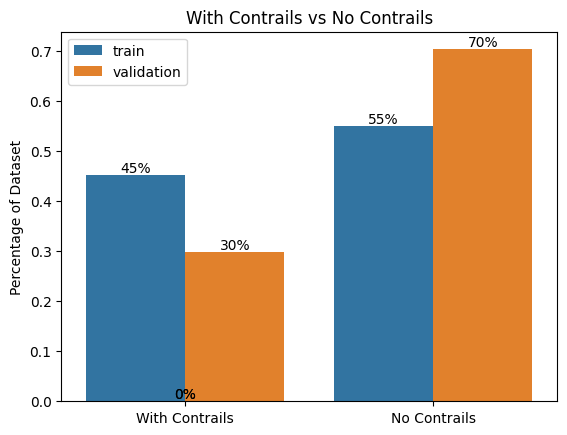

In [11]:
train_with_contrails = train_images_with_contrails / (train_images_with_contrails + train_images_without_contrails)
train_without_contrails = train_images_without_contrails / (train_images_with_contrails + train_images_without_contrails)
validation_with_contrails = validation_images_with_contrails / (validation_images_with_contrails + validation_images_without_contrails)
validation_without_contrails = validation_images_without_contrails / (validation_images_with_contrails + validation_images_without_contrails)
data = pd.DataFrame({'Type': ['With Contrails', 'No Contrails', 'With Contrails', 'No Contrails'],
        'Data': [train_with_contrails, train_without_contrails, validation_with_contrails, validation_without_contrails],
        'Data Set': ['train', 'train', 'validation', 'validation']})

ax = sns.barplot(data=data, y='Data', x="Type", hue="Data Set", orient='v')

for p in ax.patches:
    ax.annotate(format(p.get_height() * 100, '.0f') + '%',
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha = 'center', va = 'center',
                xytext = (0, 5),
                textcoords = 'offset points')
    
ax.set_xlabel('')
ax.set_ylabel('Percentage of Dataset')
ax.set_title('With Contrails vs No Contrails')

plt.legend()
plt.show()

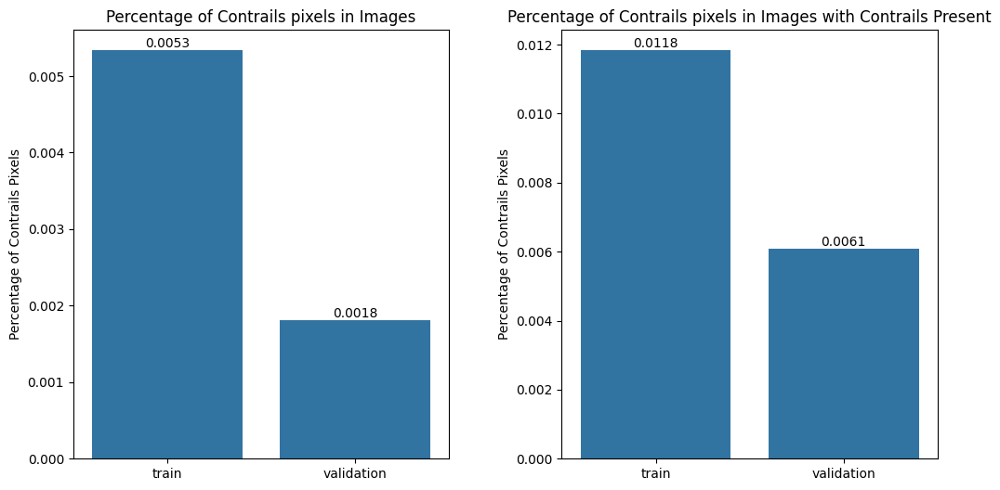

In [12]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))
fig.subplots_adjust(wspace=0.3)
axes = axes.flatten()

train_with_contrails_pix = train_contrail_pixel_count / (train_contrail_pixel_count + train_non_contrail_pixel_count)
validation_with_contrails_pix = validation_contrail_pixel_count / (validation_contrail_pixel_count + validation_non_contrail_pixel_count)
data = pd.DataFrame({'Data': [train_with_contrails_pix, validation_with_contrails_pix],
        'Data Set': ['train', 'validation']})
sns.barplot(data=data, y='Data', x="Data Set", orient='v', ax=axes[0])
for p in axes[0].patches:
    axes[0].annotate(format(p.get_height(), '.4f'),
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha = 'center', va = 'center',
                xytext = (0, 5),
                textcoords = 'offset points')
axes[0].set_xlabel('')
axes[0].set_ylabel('Percentage of Contrails Pixels')
axes[0].set_title('Percentage of Contrails pixels in Images')

train_with_contrails_pix_conly = train_contrail_pixel_count_conly / (train_contrail_pixel_count_conly + train_non_contrail_pixel_count_conly)
validation_with_contrails_pix_conly = validation_contrail_pixel_count_conly / (validation_contrail_pixel_count_conly + validation_non_contrail_pixel_count_conly)
data = pd.DataFrame({'Data': [train_with_contrails_pix_conly, validation_with_contrails_pix_conly],
        'Data Set': ['train', 'validation']})
sns.barplot(data=data, y='Data', x="Data Set", orient='v', ax=axes[1])
for p in axes[1].patches:
    axes[1].annotate(format(p.get_height(), '.4f'),
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha = 'center', va = 'center',
                xytext = (0, 5),
                textcoords = 'offset points')
axes[1].set_xlabel('')
axes[1].set_ylabel('Percentage of Contrails Pixels')
axes[1].set_title('Percentage of Contrails pixels in Images with Contrails Present')

plt.show()

In [13]:
def show_band_images(idx: str, parrent_folder: str, band: str):
    data = get_band_images(idx, parrent_folder, band)
    fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(20, 10))
    axes = axes.flatten()
    for i in range(8):
        axes[i].imshow(data[:,:,i])
        axes[i].axis('off')
    plt.show()

def show_ash_images(idx: str, parrent_folder: str):
    data = get_ash_color_images(idx, parrent_folder)
    fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(20, 10))
    axes = axes.flatten()
    for i in range(8):
        axes[i].imshow(data[:,:,:,i])
        axes[i].axis('off')
    plt.show()

def show_ash_frame(idx: str, parrent_folder: str, frame: int):
    data = get_ash_color_images(idx, parrent_folder)
    plt.imshow(data[:,:,:,frame])
    plt.show()
    
def show_mask_image(idx: str, parrent_folder: str):
    plt.imshow(get_mask_image(idx, parrent_folder))
    plt.show()

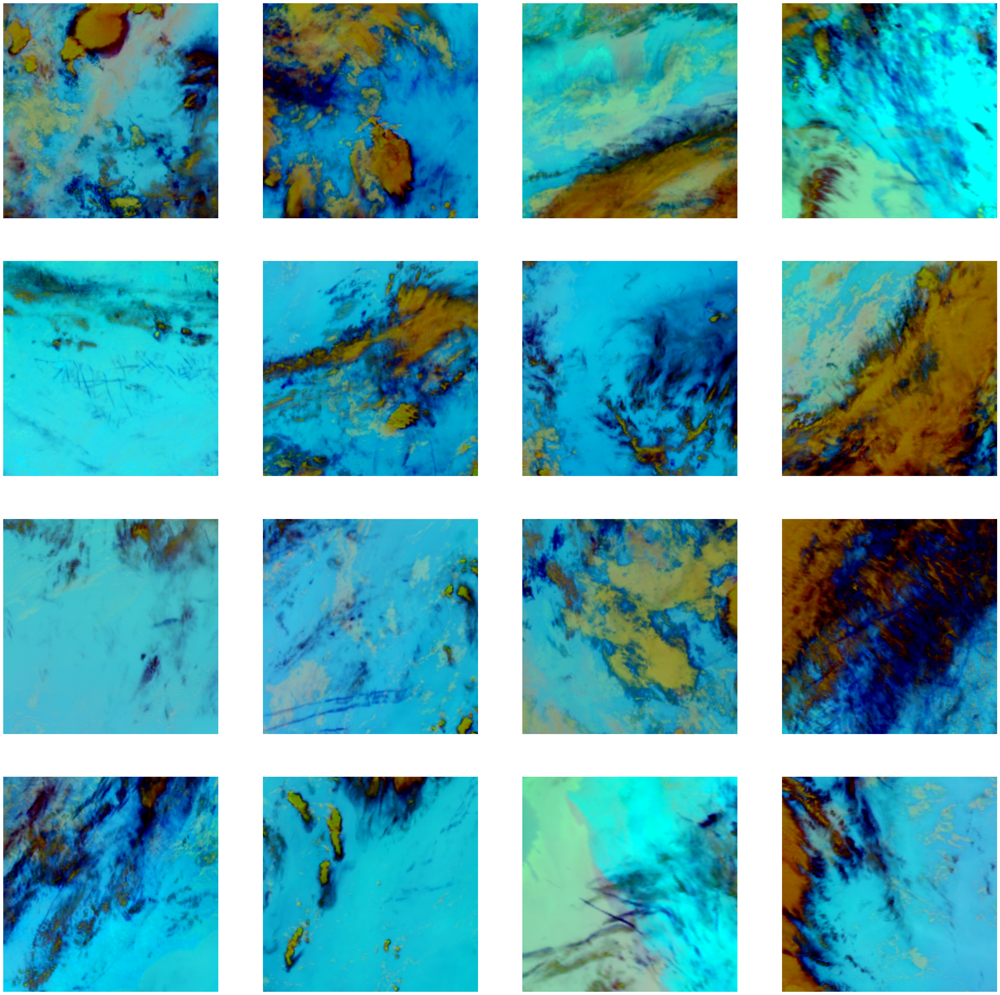

In [14]:
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(40, 40))
axes = axes.flatten()

for i in range(len(axes)):
    images = get_ash_color_images(str(df_train_idx.iloc[730 + i]['idx']), 'train')
    axes[i].imshow(images[:,:,:,4])
    axes[i].axis('off')

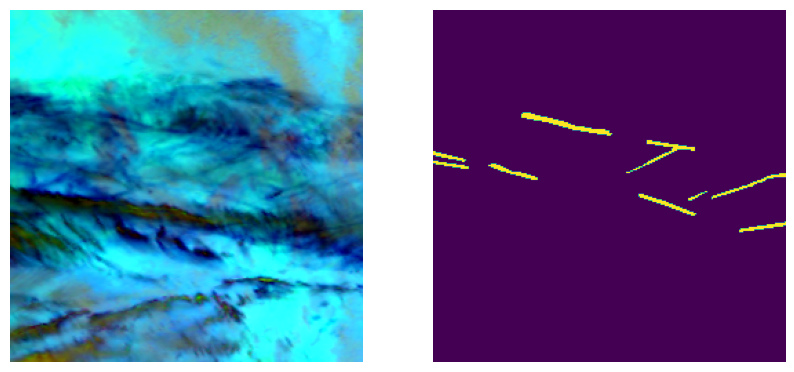

In [15]:
images = get_ash_color_images(str(df_train_idx.iloc[683]['idx']), 'train')
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
axes = axes.flatten()

axes[0].imshow(images[:,:,:,4])
axes[0].axis('off')
axes[1].imshow(get_mask_image(str(df_train_idx.iloc[683]['idx']), 'train'))
axes[1].axis('off')

plt.show()

# Model

In [16]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [17]:
class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(DoubleConv, self).__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)


class Down(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Down, self).__init__()
        self.maxpool_conv = nn.Sequential(
            nn.MaxPool2d(2),
            DoubleConv(in_channels, out_channels)
        )

    def forward(self, x):
        return self.maxpool_conv(x)


class Up(nn.Module):
    def __init__(self, in_channels, out_channels, bilinear=True):
        super(Up, self).__init__()

        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        else:
            self.up = nn.ConvTranspose2d(in_channels // 2, in_channels // 2, kernel_size=2, stride=2)

        self.conv = DoubleConv(in_channels, out_channels)

    def forward(self, x1, x2):
        x1 = self.up(x1)

        diffY = x2.size()[2] - x1.size()[2]
        diffX = x2.size()[3] - x1.size()[3]

        x1 = nn.functional.pad(x1, [diffX // 2, diffX - diffX // 2, diffY // 2, diffY - diffY // 2])
        
        x = torch.cat([x2, x1], dim=1)
        return self.conv(x)


class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()
        # Define your layers
        self.inc = DoubleConv(24, 64)
        self.down1 = Down(64, 128)
        self.down2 = Down(128, 256)
        self.down3 = Down(256, 512)
        self.down4 = Down(512, 512)
        self.up1 = Up(1024, 256)
        self.up2 = Up(512, 128)
        self.up3 = Up(256, 64)
        self.up4 = Up(128, 64)
        self.outc = nn.Conv2d(64, 1, kernel_size=1)

    def forward(self, x):
        # Forward pass through the layers
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)
        x = self.outc(x)
        return x

In [18]:
summary(UNet().to(device), input_size=(24, 128, 128))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 128, 128]          13,888
       BatchNorm2d-2         [-1, 64, 128, 128]             128
              ReLU-3         [-1, 64, 128, 128]               0
            Conv2d-4         [-1, 64, 128, 128]          36,928
       BatchNorm2d-5         [-1, 64, 128, 128]             128
              ReLU-6         [-1, 64, 128, 128]               0
        DoubleConv-7         [-1, 64, 128, 128]               0
         MaxPool2d-8           [-1, 64, 64, 64]               0
            Conv2d-9          [-1, 128, 64, 64]          73,856
      BatchNorm2d-10          [-1, 128, 64, 64]             256
             ReLU-11          [-1, 128, 64, 64]               0
           Conv2d-12          [-1, 128, 64, 64]         147,584
      BatchNorm2d-13          [-1, 128, 64, 64]             256
             ReLU-14          [-1, 128,

# Trainer

In [19]:
class Dice(nn.Module):
    def __init__(self, use_sigmoid=True):
        super(Dice, self).__init__()
        self.sigmoid = nn.Sigmoid()
        self.use_sigmoid = use_sigmoid

    def forward(self, inputs, targets, smooth=1):
        if self.use_sigmoid:
            inputs = self.sigmoid(inputs)       
        
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        
        intersection = (inputs * targets).sum()
        dice = (2.0 *intersection + smooth)/(inputs.sum() + targets.sum() + smooth)  
        
        return dice
    
dice = Dice()

In [20]:
class MyTrainer:
    def __init__(self, model, optimizer, loss_fn, lr_scheduler):
        self.validation_losses = []
        self.batch_losses = []
        self.epoch_losses = []
        self.learning_rates = []
        self.model = model
        self.optimizer = optimizer
        self.loss_fn = loss_fn
        self.lr_scheduler = lr_scheduler
        self._check_optim_net_aligned()

    # Ensures that the given optimizer points to the given model
    def _check_optim_net_aligned(self):
        assert self.optimizer.param_groups[0]['params'] == list(self.model.parameters())

    # Trains the model
    def fit(self,
            train_dataloader: DataLoader,
            test_dataloader: DataLoader,
            epochs: int = 10,
            eval_every: int = 1,
            ):
  
        for e in range(epochs):
            print("New learning rate: {}".format(self.lr_scheduler.get_last_lr()))
            self.learning_rates.append(self.lr_scheduler.get_last_lr()[0])

            # Stores data about the batch
            batch_losses = []
            sub_batch_losses = []

            for i, data in enumerate(tqdm(train_dataloader, desc=f"Epoch {e + 1}/{epochs} Training")):
                self.model.train()
                if i % 100 == 0:
                    print(f'epotch: {e} batch: {i}/{len(train_dataloader)} loss: {torch.Tensor(sub_batch_losses).mean()}')
                    sub_batch_losses.clear()
                # Every data instance is an input + label pair
                images, mask = data
                
                if torch.cuda.is_available():
                    images = images.cuda()
                    mask = mask.cuda()

                # Zero your gradients for every batch!
                self.optimizer.zero_grad()
                # Make predictions for this batch
                outputs = self.model(images)
                # Compute the loss and its gradients
                loss = self.loss_fn(outputs, mask)
                loss.backward()
                # Adjust learning weights
                self.optimizer.step()

                # Saves data
                self.batch_losses.append(loss.item())
                batch_losses.append(loss)
                sub_batch_losses.append(loss)

            # Adjusts learning rate
            if self.lr_scheduler is not None:
                self.lr_scheduler.step()

            # Reports on the path
            mean_epoch_loss = torch.Tensor(batch_losses).mean()
            self.epoch_losses.append(mean_epoch_loss.item())
            print('Train Epoch: {} Average Loss: {:.6f}'.format(e, mean_epoch_loss))

            # Reports on the training progress
            if (e + 1) % eval_every == 0:
                torch.save(self.model.state_dict(), "checkpoints/" + type(self.model).__name__ + "_model_checkpoint_e" + str(e) + ".pt")
                with torch.no_grad():
                    self.model.eval()
                    losses = []
                    for i, data in enumerate(tqdm(test_dataloader, desc=f"Epoch {e + 1}/{epochs} Validation")):
                        # Every data instance is an input + label pair
                        images, mask = data

                        if torch.cuda.is_available():
                            images = images.cuda()
                            mask = mask.cuda()

                        output = self.model(images)
                        loss = self.loss_fn(output, mask)
                        losses.append(loss.item())
                        
                    avg_loss = torch.Tensor(losses).mean().item()
                    self.validation_losses.append(avg_loss)
                    print("Validation loss after", (e + 1), "epochs was", round(avg_loss, 4))

# Dataset

In [21]:
class ContrailsAshDataset(torch.utils.data.Dataset):
    def __init__(self, parrent_folder: str):
        self.df_idx: pd.DataFrame = pd.DataFrame({'idx': os.listdir(f'/media/jychpr/ADATA SD810/kaggle_data/google-research-identify-contrails-reduce-global-warming/{parrent_folder}')})
        self.parrent_folder: str = parrent_folder

    def __len__(self):
        return len(self.df_idx)

    def __getitem__(self, idx):
        image_id: str = str(self.df_idx.iloc[idx]['idx'])
        images = torch.tensor(np.reshape(get_ash_color_images(image_id, self.parrent_folder, get_mask_frame_only=False), (256, 256, 24))).to(torch.float32).permute(2, 0, 1)
        mask = torch.tensor(get_mask_image(image_id, self.parrent_folder)).to(torch.float32).permute(2, 0, 1)
        return images, mask

In [22]:
dataset_train = ContrailsAshDataset('train')
dataset_validation = ContrailsAshDataset('validation')

data_loader_train = DataLoader(dataset_train, batch_size=8, shuffle=True, num_workers=2)
data_loader_validation = DataLoader(dataset_validation, batch_size=8, shuffle=True, num_workers=2)

# Train

In [23]:
train = True

In [24]:
if train:
    model = UNet()
    model.to(device)

    criterion = nn.BCEWithLogitsLoss(pos_weight=torch.tensor(100))
    optimizer = optim.Adam(model.parameters(), lr=0.01)
    lr_scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, 0.70)

    num_epochs = 10

    trainer = MyTrainer(model, optimizer, criterion, lr_scheduler)
    trainer.fit(data_loader_train, data_loader_validation, epochs=num_epochs)
# else:
#     model = UNet()
#     model.load_state_dict(torch.load('/kaggle/input/contrails-unet-pretrained/unet.pt'))
#     model.eval()
#     model.to(device)

New learning rate: [0.01]


Epoch 1/10 Training:   0%|                                                                                | 0/2567 [00:00<?, ?it/s]

epotch: 0 batch: 0/2567 loss: nan


Epoch 1/10 Training:   4%|██▊                                                                   | 101/2567 [00:11<04:26,  9.26it/s]

epotch: 0 batch: 100/2567 loss: 0.9413504600524902


Epoch 1/10 Training:   8%|█████▍                                                                | 201/2567 [00:22<04:15,  9.27it/s]

epotch: 0 batch: 200/2567 loss: 0.9735574126243591


Epoch 1/10 Training:  12%|████████▏                                                             | 301/2567 [00:33<04:06,  9.19it/s]

epotch: 0 batch: 300/2567 loss: 0.8375086188316345


Epoch 1/10 Training:  16%|██████████▉                                                           | 401/2567 [00:43<03:56,  9.18it/s]

epotch: 0 batch: 400/2567 loss: 0.7651748061180115


Epoch 1/10 Training:  20%|█████████████▋                                                        | 501/2567 [00:54<03:47,  9.07it/s]

epotch: 0 batch: 500/2567 loss: 0.6422601938247681


Epoch 1/10 Training:  23%|████████████████▍                                                     | 601/2567 [01:05<03:36,  9.08it/s]

epotch: 0 batch: 600/2567 loss: 0.5655788779258728


Epoch 1/10 Training:  27%|███████████████████                                                   | 701/2567 [01:17<03:25,  9.09it/s]

epotch: 0 batch: 700/2567 loss: 0.6234065890312195


Epoch 1/10 Training:  31%|█████████████████████▊                                                | 801/2567 [01:28<03:17,  8.92it/s]

epotch: 0 batch: 800/2567 loss: 0.5720451474189758


Epoch 1/10 Training:  35%|████████████████████████▌                                             | 901/2567 [01:39<03:05,  8.99it/s]

epotch: 0 batch: 900/2567 loss: 0.5750645399093628


Epoch 1/10 Training:  39%|██████████████████████████▉                                          | 1001/2567 [01:50<02:51,  9.11it/s]

epotch: 0 batch: 1000/2567 loss: 0.5574257373809814


Epoch 1/10 Training:  43%|█████████████████████████████▌                                       | 1101/2567 [02:01<02:42,  9.04it/s]

epotch: 0 batch: 1100/2567 loss: 0.5770927667617798


Epoch 1/10 Training:  47%|████████████████████████████████▎                                    | 1201/2567 [02:12<02:30,  9.08it/s]

epotch: 0 batch: 1200/2567 loss: 0.5243661999702454


Epoch 1/10 Training:  51%|██████████████████████████████████▉                                  | 1301/2567 [02:23<02:20,  8.98it/s]

epotch: 0 batch: 1300/2567 loss: 0.5703442692756653


Epoch 1/10 Training:  55%|█████████████████████████████████████▋                               | 1401/2567 [02:34<02:09,  9.01it/s]

epotch: 0 batch: 1400/2567 loss: 0.555575966835022


Epoch 1/10 Training:  58%|████████████████████████████████████████▎                            | 1501/2567 [02:45<01:58,  9.03it/s]

epotch: 0 batch: 1500/2567 loss: 0.5115960240364075


Epoch 1/10 Training:  62%|███████████████████████████████████████████                          | 1601/2567 [02:56<01:46,  9.08it/s]

epotch: 0 batch: 1600/2567 loss: 0.5214250087738037


Epoch 1/10 Training:  66%|█████████████████████████████████████████████▋                       | 1701/2567 [03:07<01:35,  9.08it/s]

epotch: 0 batch: 1700/2567 loss: 0.4944430887699127


Epoch 1/10 Training:  70%|████████████████████████████████████████████████▍                    | 1801/2567 [03:18<01:25,  9.00it/s]

epotch: 0 batch: 1800/2567 loss: 0.5235344171524048


Epoch 1/10 Training:  74%|███████████████████████████████████████████████████                  | 1901/2567 [03:29<01:13,  9.08it/s]

epotch: 0 batch: 1900/2567 loss: 0.49317464232444763


Epoch 1/10 Training:  78%|█████████████████████████████████████████████████████▊               | 2001/2567 [03:40<01:02,  9.02it/s]

epotch: 0 batch: 2000/2567 loss: 0.4703584313392639


Epoch 1/10 Training:  82%|████████████████████████████████████████████████████████▍            | 2101/2567 [03:51<00:51,  9.06it/s]

epotch: 0 batch: 2100/2567 loss: 0.43569839000701904


Epoch 1/10 Training:  86%|███████████████████████████████████████████████████████████▏         | 2201/2567 [04:02<00:40,  9.03it/s]

epotch: 0 batch: 2200/2567 loss: 0.47562310099601746


Epoch 1/10 Training:  90%|█████████████████████████████████████████████████████████████▊       | 2301/2567 [04:13<00:29,  9.10it/s]

epotch: 0 batch: 2300/2567 loss: 0.4854997396469116


Epoch 1/10 Training:  94%|████████████████████████████████████████████████████████████████▌    | 2401/2567 [04:24<00:18,  9.02it/s]

epotch: 0 batch: 2400/2567 loss: 0.500511109828949


Epoch 1/10 Training:  97%|███████████████████████████████████████████████████████████████████▏ | 2501/2567 [04:35<00:07,  9.10it/s]

epotch: 0 batch: 2500/2567 loss: 0.4615263044834137


Epoch 1/10 Training: 100%|█████████████████████████████████████████████████████████████████████| 2567/2567 [04:42<00:00,  9.09it/s]


Train Epoch: 0 Average Loss: 0.582342


Epoch 1/10 Validation: 100%|█████████████████████████████████████████████████████████████████████| 232/232 [00:16<00:00, 13.82it/s]


Validation loss after 1 epochs was 0.3195
New learning rate: [0.006999999999999999]


Epoch 2/10 Training:   0%|                                                                        | 1/2567 [00:00<12:33,  3.40it/s]

epotch: 1 batch: 0/2567 loss: nan


Epoch 2/10 Training:   4%|██▊                                                                   | 101/2567 [00:11<04:34,  8.98it/s]

epotch: 1 batch: 100/2567 loss: 0.44074857234954834


Epoch 2/10 Training:   8%|█████▍                                                                | 201/2567 [00:22<04:21,  9.06it/s]

epotch: 1 batch: 200/2567 loss: 0.44503143429756165


Epoch 2/10 Training:  12%|████████▏                                                             | 301/2567 [00:33<04:08,  9.13it/s]

epotch: 1 batch: 300/2567 loss: 0.425593763589859


Epoch 2/10 Training:  16%|██████████▉                                                           | 401/2567 [00:44<03:56,  9.15it/s]

epotch: 1 batch: 400/2567 loss: 0.43181079626083374


Epoch 2/10 Training:  20%|█████████████▋                                                        | 501/2567 [00:55<03:46,  9.14it/s]

epotch: 1 batch: 500/2567 loss: 0.445975124835968


Epoch 2/10 Training:  23%|████████████████▍                                                     | 601/2567 [01:06<03:37,  9.05it/s]

epotch: 1 batch: 600/2567 loss: 0.42122191190719604


Epoch 2/10 Training:  27%|███████████████████                                                   | 701/2567 [01:17<03:26,  9.05it/s]

epotch: 1 batch: 700/2567 loss: 0.3706625998020172


Epoch 2/10 Training:  31%|█████████████████████▊                                                | 801/2567 [01:28<03:13,  9.14it/s]

epotch: 1 batch: 800/2567 loss: 0.44310104846954346


Epoch 2/10 Training:  35%|████████████████████████▌                                             | 901/2567 [01:39<03:04,  9.05it/s]

epotch: 1 batch: 900/2567 loss: 0.4162489175796509


Epoch 2/10 Training:  39%|██████████████████████████▉                                          | 1001/2567 [01:50<02:54,  8.99it/s]

epotch: 1 batch: 1000/2567 loss: 0.3883295953273773


Epoch 2/10 Training:  43%|█████████████████████████████▌                                       | 1101/2567 [02:01<02:42,  9.04it/s]

epotch: 1 batch: 1100/2567 loss: 0.39111804962158203


Epoch 2/10 Training:  47%|████████████████████████████████▎                                    | 1201/2567 [02:12<02:34,  8.83it/s]

epotch: 1 batch: 1200/2567 loss: 0.4120171070098877


Epoch 2/10 Training:  51%|██████████████████████████████████▉                                  | 1301/2567 [02:23<02:20,  9.04it/s]

epotch: 1 batch: 1300/2567 loss: 0.3347027599811554


Epoch 2/10 Training:  55%|█████████████████████████████████████▋                               | 1401/2567 [02:34<02:08,  9.09it/s]

epotch: 1 batch: 1400/2567 loss: 0.38752007484436035


Epoch 2/10 Training:  58%|████████████████████████████████████████▎                            | 1501/2567 [02:45<01:57,  9.06it/s]

epotch: 1 batch: 1500/2567 loss: 0.3417738974094391


Epoch 2/10 Training:  62%|███████████████████████████████████████████                          | 1601/2567 [02:56<01:46,  9.09it/s]

epotch: 1 batch: 1600/2567 loss: 0.3786534368991852


Epoch 2/10 Training:  66%|█████████████████████████████████████████████▋                       | 1701/2567 [03:07<01:35,  9.11it/s]

epotch: 1 batch: 1700/2567 loss: 0.3109334409236908


Epoch 2/10 Training:  70%|████████████████████████████████████████████████▍                    | 1801/2567 [03:18<01:23,  9.15it/s]

epotch: 1 batch: 1800/2567 loss: 0.35153278708457947


Epoch 2/10 Training:  74%|███████████████████████████████████████████████████                  | 1901/2567 [03:29<01:14,  8.98it/s]

epotch: 1 batch: 1900/2567 loss: 0.3292218744754791


Epoch 2/10 Training:  78%|█████████████████████████████████████████████████████▊               | 2001/2567 [03:40<01:15,  7.54it/s]

epotch: 1 batch: 2000/2567 loss: 0.3094015121459961


Epoch 2/10 Training:  82%|████████████████████████████████████████████████████████▍            | 2101/2567 [03:51<00:50,  9.14it/s]

epotch: 1 batch: 2100/2567 loss: 0.35505545139312744


Epoch 2/10 Training:  86%|███████████████████████████████████████████████████████████▏         | 2201/2567 [04:02<00:40,  9.14it/s]

epotch: 1 batch: 2200/2567 loss: 0.3013366758823395


Epoch 2/10 Training:  90%|█████████████████████████████████████████████████████████████▊       | 2301/2567 [04:13<00:29,  9.12it/s]

epotch: 1 batch: 2300/2567 loss: 0.3123894929885864


Epoch 2/10 Training:  94%|████████████████████████████████████████████████████████████████▌    | 2401/2567 [04:24<00:18,  9.14it/s]

epotch: 1 batch: 2400/2567 loss: 0.31536656618118286


Epoch 2/10 Training:  97%|███████████████████████████████████████████████████████████████████▏ | 2501/2567 [04:35<00:07,  8.39it/s]

epotch: 1 batch: 2500/2567 loss: 0.32083839178085327


Epoch 2/10 Training: 100%|█████████████████████████████████████████████████████████████████████| 2567/2567 [04:43<00:00,  9.07it/s]


Train Epoch: 1 Average Loss: 0.374413


Epoch 2/10 Validation: 100%|█████████████████████████████████████████████████████████████████████| 232/232 [00:14<00:00, 16.11it/s]


Validation loss after 2 epochs was 0.228
New learning rate: [0.004899999999999999]


Epoch 3/10 Training:   0%|                                                                        | 1/2567 [00:00<14:32,  2.94it/s]

epotch: 2 batch: 0/2567 loss: nan


Epoch 3/10 Training:   4%|██▊                                                                   | 101/2567 [00:11<04:35,  8.94it/s]

epotch: 2 batch: 100/2567 loss: 0.3135417699813843


Epoch 3/10 Training:   8%|█████▍                                                                | 201/2567 [00:22<04:22,  9.00it/s]

epotch: 2 batch: 200/2567 loss: 0.3163037598133087


Epoch 3/10 Training:  12%|████████▏                                                             | 301/2567 [00:33<04:08,  9.13it/s]

epotch: 2 batch: 300/2567 loss: 0.26827138662338257


Epoch 3/10 Training:  16%|██████████▉                                                           | 401/2567 [00:44<03:59,  9.03it/s]

epotch: 2 batch: 400/2567 loss: 0.2657688856124878


Epoch 3/10 Training:  20%|█████████████▋                                                        | 501/2567 [00:55<03:48,  9.04it/s]

epotch: 2 batch: 500/2567 loss: 0.26983365416526794


Epoch 3/10 Training:  23%|████████████████▍                                                     | 601/2567 [01:06<03:35,  9.14it/s]

epotch: 2 batch: 600/2567 loss: 0.26158976554870605


Epoch 3/10 Training:  27%|███████████████████                                                   | 701/2567 [01:17<03:24,  9.13it/s]

epotch: 2 batch: 700/2567 loss: 0.2687889635562897


Epoch 3/10 Training:  31%|█████████████████████▊                                                | 801/2567 [01:28<03:14,  9.08it/s]

epotch: 2 batch: 800/2567 loss: 0.2538401782512665


Epoch 3/10 Training:  35%|████████████████████████▌                                             | 901/2567 [01:39<03:02,  9.10it/s]

epotch: 2 batch: 900/2567 loss: 0.2679073214530945


Epoch 3/10 Training:  39%|██████████████████████████▉                                          | 1001/2567 [01:50<02:53,  9.05it/s]

epotch: 2 batch: 1000/2567 loss: 0.24122753739356995


Epoch 3/10 Training:  43%|█████████████████████████████▌                                       | 1101/2567 [02:01<02:41,  9.08it/s]

epotch: 2 batch: 1100/2567 loss: 0.25071078538894653


Epoch 3/10 Training:  47%|████████████████████████████████▎                                    | 1201/2567 [02:12<02:31,  9.01it/s]

epotch: 2 batch: 1200/2567 loss: 0.2472500056028366


Epoch 3/10 Training:  51%|██████████████████████████████████▉                                  | 1301/2567 [02:23<02:19,  9.05it/s]

epotch: 2 batch: 1300/2567 loss: 0.24921683967113495


Epoch 3/10 Training:  55%|█████████████████████████████████████▋                               | 1401/2567 [02:34<02:08,  9.11it/s]

epotch: 2 batch: 1400/2567 loss: 0.26519089937210083


Epoch 3/10 Training:  58%|████████████████████████████████████████▎                            | 1501/2567 [02:45<01:56,  9.13it/s]

epotch: 2 batch: 1500/2567 loss: 0.2487635463476181


Epoch 3/10 Training:  62%|███████████████████████████████████████████                          | 1601/2567 [02:56<01:46,  9.08it/s]

epotch: 2 batch: 1600/2567 loss: 0.2390843778848648


Epoch 3/10 Training:  66%|█████████████████████████████████████████████▋                       | 1701/2567 [03:07<01:35,  9.05it/s]

epotch: 2 batch: 1700/2567 loss: 0.24866820871829987


Epoch 3/10 Training:  70%|████████████████████████████████████████████████▍                    | 1801/2567 [03:18<01:24,  9.07it/s]

epotch: 2 batch: 1800/2567 loss: 0.24956201016902924


Epoch 3/10 Training:  74%|███████████████████████████████████████████████████                  | 1901/2567 [03:29<01:13,  9.06it/s]

epotch: 2 batch: 1900/2567 loss: 0.23446550965309143


Epoch 3/10 Training:  78%|█████████████████████████████████████████████████████▊               | 2001/2567 [03:40<01:02,  9.09it/s]

epotch: 2 batch: 2000/2567 loss: 0.21793170273303986


Epoch 3/10 Training:  82%|████████████████████████████████████████████████████████▍            | 2101/2567 [03:51<00:51,  9.04it/s]

epotch: 2 batch: 2100/2567 loss: 0.26856744289398193


Epoch 3/10 Training:  86%|███████████████████████████████████████████████████████████▏         | 2201/2567 [04:02<00:40,  9.08it/s]

epotch: 2 batch: 2200/2567 loss: 0.23144285380840302


Epoch 3/10 Training:  90%|█████████████████████████████████████████████████████████████▊       | 2301/2567 [04:13<00:29,  9.16it/s]

epotch: 2 batch: 2300/2567 loss: 0.23961542546749115


Epoch 3/10 Training:  94%|████████████████████████████████████████████████████████████████▌    | 2401/2567 [04:24<00:18,  9.10it/s]

epotch: 2 batch: 2400/2567 loss: 0.2535281777381897


Epoch 3/10 Training:  97%|███████████████████████████████████████████████████████████████████▏ | 2501/2567 [04:34<00:07,  9.17it/s]

epotch: 2 batch: 2500/2567 loss: 0.22451762855052948


Epoch 3/10 Training: 100%|█████████████████████████████████████████████████████████████████████| 2567/2567 [04:42<00:00,  9.10it/s]


Train Epoch: 2 Average Loss: 0.254651


Epoch 3/10 Validation: 100%|█████████████████████████████████████████████████████████████████████| 232/232 [00:16<00:00, 14.14it/s]


Validation loss after 3 epochs was 0.1539
New learning rate: [0.003429999999999999]


Epoch 4/10 Training:   0%|                                                                        | 1/2567 [00:00<14:38,  2.92it/s]

epotch: 3 batch: 0/2567 loss: nan


Epoch 4/10 Training:   4%|██▊                                                                   | 101/2567 [00:11<04:28,  9.18it/s]

epotch: 3 batch: 100/2567 loss: 0.21658296883106232


Epoch 4/10 Training:   8%|█████▍                                                                | 201/2567 [00:22<04:18,  9.15it/s]

epotch: 3 batch: 200/2567 loss: 0.22450008988380432


Epoch 4/10 Training:  12%|████████▏                                                             | 301/2567 [00:33<04:09,  9.09it/s]

epotch: 3 batch: 300/2567 loss: 0.2437131106853485


Epoch 4/10 Training:  16%|██████████▉                                                           | 401/2567 [00:44<04:00,  9.00it/s]

epotch: 3 batch: 400/2567 loss: 0.23558829724788666


Epoch 4/10 Training:  20%|█████████████▋                                                        | 501/2567 [00:55<03:48,  9.05it/s]

epotch: 3 batch: 500/2567 loss: 0.21796908974647522


Epoch 4/10 Training:  23%|████████████████▍                                                     | 601/2567 [01:06<03:34,  9.15it/s]

epotch: 3 batch: 600/2567 loss: 0.20694909989833832


Epoch 4/10 Training:  27%|███████████████████                                                   | 701/2567 [01:17<03:25,  9.07it/s]

epotch: 3 batch: 700/2567 loss: 0.21107810735702515


Epoch 4/10 Training:  31%|█████████████████████▊                                                | 801/2567 [01:28<03:14,  9.07it/s]

epotch: 3 batch: 800/2567 loss: 0.20380710065364838


Epoch 4/10 Training:  35%|████████████████████████▌                                             | 901/2567 [01:39<03:03,  9.09it/s]

epotch: 3 batch: 900/2567 loss: 0.19385288655757904


Epoch 4/10 Training:  39%|██████████████████████████▉                                          | 1001/2567 [01:50<02:52,  9.09it/s]

epotch: 3 batch: 1000/2567 loss: 0.20928409695625305


Epoch 4/10 Training:  43%|█████████████████████████████▌                                       | 1101/2567 [02:01<02:40,  9.11it/s]

epotch: 3 batch: 1100/2567 loss: 0.18800504505634308


Epoch 4/10 Training:  47%|████████████████████████████████▎                                    | 1201/2567 [02:12<02:29,  9.13it/s]

epotch: 3 batch: 1200/2567 loss: 0.20908594131469727


Epoch 4/10 Training:  51%|██████████████████████████████████▉                                  | 1301/2567 [02:23<02:19,  9.08it/s]

epotch: 3 batch: 1300/2567 loss: 0.20475487411022186


Epoch 4/10 Training:  55%|█████████████████████████████████████▋                               | 1401/2567 [02:34<02:07,  9.13it/s]

epotch: 3 batch: 1400/2567 loss: 0.1920131891965866


Epoch 4/10 Training:  58%|████████████████████████████████████████▎                            | 1501/2567 [02:45<01:57,  9.09it/s]

epotch: 3 batch: 1500/2567 loss: 0.20724724233150482


Epoch 4/10 Training:  62%|███████████████████████████████████████████                          | 1601/2567 [02:56<01:48,  8.92it/s]

epotch: 3 batch: 1600/2567 loss: 0.21923714876174927


Epoch 4/10 Training:  66%|█████████████████████████████████████████████▋                       | 1701/2567 [03:07<01:35,  9.10it/s]

epotch: 3 batch: 1700/2567 loss: 0.20723241567611694


Epoch 4/10 Training:  70%|████████████████████████████████████████████████▍                    | 1801/2567 [03:18<01:24,  9.09it/s]

epotch: 3 batch: 1800/2567 loss: 0.19157887995243073


Epoch 4/10 Training:  74%|███████████████████████████████████████████████████                  | 1901/2567 [03:30<01:13,  9.09it/s]

epotch: 3 batch: 1900/2567 loss: 0.20518457889556885


Epoch 4/10 Training:  78%|█████████████████████████████████████████████████████▊               | 2001/2567 [03:41<01:01,  9.15it/s]

epotch: 3 batch: 2000/2567 loss: 0.2007133513689041


Epoch 4/10 Training:  82%|████████████████████████████████████████████████████████▍            | 2101/2567 [03:52<00:51,  9.07it/s]

epotch: 3 batch: 2100/2567 loss: 0.22251781821250916


Epoch 4/10 Training:  86%|███████████████████████████████████████████████████████████▏         | 2201/2567 [04:03<00:40,  9.05it/s]

epotch: 3 batch: 2200/2567 loss: 0.2078879177570343


Epoch 4/10 Training:  90%|█████████████████████████████████████████████████████████████▊       | 2301/2567 [04:14<00:29,  9.11it/s]

epotch: 3 batch: 2300/2567 loss: 0.1912676841020584


Epoch 4/10 Training:  94%|████████████████████████████████████████████████████████████████▌    | 2401/2567 [04:25<00:18,  9.03it/s]

epotch: 3 batch: 2400/2567 loss: 0.1918543428182602


Epoch 4/10 Training:  97%|███████████████████████████████████████████████████████████████████▏ | 2501/2567 [04:36<00:07,  9.12it/s]

epotch: 3 batch: 2500/2567 loss: 0.21139413118362427


Epoch 4/10 Training: 100%|█████████████████████████████████████████████████████████████████████| 2567/2567 [04:43<00:00,  9.06it/s]


Train Epoch: 3 Average Loss: 0.207546


Epoch 4/10 Validation: 100%|█████████████████████████████████████████████████████████████████████| 232/232 [00:18<00:00, 12.24it/s]


Validation loss after 4 epochs was 0.1206
New learning rate: [0.002400999999999999]


Epoch 5/10 Training:   0%|                                                                        | 1/2567 [00:00<14:59,  2.85it/s]

epotch: 4 batch: 0/2567 loss: nan


Epoch 5/10 Training:   4%|██▊                                                                   | 101/2567 [00:11<04:28,  9.18it/s]

epotch: 4 batch: 100/2567 loss: 0.19530215859413147


Epoch 5/10 Training:   8%|█████▍                                                                | 201/2567 [00:22<04:18,  9.15it/s]

epotch: 4 batch: 200/2567 loss: 0.18099716305732727


Epoch 5/10 Training:  12%|████████▏                                                             | 301/2567 [00:33<04:09,  9.08it/s]

epotch: 4 batch: 300/2567 loss: 0.19019313156604767


Epoch 5/10 Training:  16%|██████████▉                                                           | 401/2567 [00:44<04:00,  8.99it/s]

epotch: 4 batch: 400/2567 loss: 0.1993369609117508


Epoch 5/10 Training:  20%|█████████████▋                                                        | 501/2567 [00:55<03:46,  9.10it/s]

epotch: 4 batch: 500/2567 loss: 0.1671483963727951


Epoch 5/10 Training:  23%|████████████████▍                                                     | 601/2567 [01:06<03:37,  9.03it/s]

epotch: 4 batch: 600/2567 loss: 0.1961013227701187


Epoch 5/10 Training:  27%|███████████████████                                                   | 701/2567 [01:17<03:26,  9.05it/s]

epotch: 4 batch: 700/2567 loss: 0.18791763484477997


Epoch 5/10 Training:  31%|█████████████████████▊                                                | 801/2567 [01:28<03:17,  8.93it/s]

epotch: 4 batch: 800/2567 loss: 0.19908855855464935


Epoch 5/10 Training:  35%|████████████████████████▌                                             | 901/2567 [01:39<03:03,  9.10it/s]

epotch: 4 batch: 900/2567 loss: 0.17047813534736633


Epoch 5/10 Training:  39%|██████████████████████████▉                                          | 1001/2567 [01:50<02:55,  8.93it/s]

epotch: 4 batch: 1000/2567 loss: 0.16614049673080444


Epoch 5/10 Training:  43%|█████████████████████████████▌                                       | 1101/2567 [02:01<02:42,  9.03it/s]

epotch: 4 batch: 1100/2567 loss: 0.18589866161346436


Epoch 5/10 Training:  47%|████████████████████████████████▎                                    | 1201/2567 [02:12<02:32,  8.97it/s]

epotch: 4 batch: 1200/2567 loss: 0.1963438093662262


Epoch 5/10 Training:  51%|██████████████████████████████████▉                                  | 1301/2567 [02:23<02:21,  8.95it/s]

epotch: 4 batch: 1300/2567 loss: 0.18841373920440674


Epoch 5/10 Training:  55%|█████████████████████████████████████▋                               | 1401/2567 [02:34<02:08,  9.07it/s]

epotch: 4 batch: 1400/2567 loss: 0.18865695595741272


Epoch 5/10 Training:  58%|████████████████████████████████████████▎                            | 1501/2567 [02:45<01:58,  8.98it/s]

epotch: 4 batch: 1500/2567 loss: 0.17626157402992249


Epoch 5/10 Training:  62%|███████████████████████████████████████████                          | 1601/2567 [02:57<01:46,  9.09it/s]

epotch: 4 batch: 1600/2567 loss: 0.16987624764442444


Epoch 5/10 Training:  66%|█████████████████████████████████████████████▋                       | 1701/2567 [03:08<01:37,  8.88it/s]

epotch: 4 batch: 1700/2567 loss: 0.15856824815273285


Epoch 5/10 Training:  70%|████████████████████████████████████████████████▍                    | 1801/2567 [03:19<01:25,  8.99it/s]

epotch: 4 batch: 1800/2567 loss: 0.19025203585624695


Epoch 5/10 Training:  74%|███████████████████████████████████████████████████                  | 1901/2567 [03:30<01:13,  9.09it/s]

epotch: 4 batch: 1900/2567 loss: 0.1743677258491516


Epoch 5/10 Training:  78%|█████████████████████████████████████████████████████▊               | 2001/2567 [03:41<01:03,  8.93it/s]

epotch: 4 batch: 2000/2567 loss: 0.15410280227661133


Epoch 5/10 Training:  82%|████████████████████████████████████████████████████████▍            | 2101/2567 [03:52<00:51,  9.07it/s]

epotch: 4 batch: 2100/2567 loss: 0.18885530531406403


Epoch 5/10 Training:  86%|███████████████████████████████████████████████████████████▏         | 2201/2567 [04:03<00:40,  9.11it/s]

epotch: 4 batch: 2200/2567 loss: 0.17158938944339752


Epoch 5/10 Training:  90%|█████████████████████████████████████████████████████████████▊       | 2301/2567 [04:14<00:29,  8.98it/s]

epotch: 4 batch: 2300/2567 loss: 0.16898010671138763


Epoch 5/10 Training:  94%|████████████████████████████████████████████████████████████████▌    | 2401/2567 [04:25<00:19,  8.42it/s]

epotch: 4 batch: 2400/2567 loss: 0.16942253708839417


Epoch 5/10 Training:  97%|███████████████████████████████████████████████████████████████████▏ | 2501/2567 [04:37<00:07,  8.68it/s]

epotch: 4 batch: 2500/2567 loss: 0.20512837171554565


Epoch 5/10 Training: 100%|█████████████████████████████████████████████████████████████████████| 2567/2567 [04:44<00:00,  9.01it/s]


Train Epoch: 4 Average Loss: 0.181964


Epoch 5/10 Validation: 100%|█████████████████████████████████████████████████████████████████████| 232/232 [00:13<00:00, 16.85it/s]


Validation loss after 5 epochs was 0.1261
New learning rate: [0.0016806999999999992]


Epoch 6/10 Training:   0%|                                                                        | 1/2567 [00:00<16:28,  2.60it/s]

epotch: 5 batch: 0/2567 loss: nan


Epoch 6/10 Training:   4%|██▊                                                                   | 101/2567 [00:11<04:35,  8.96it/s]

epotch: 5 batch: 100/2567 loss: 0.1774267554283142


Epoch 6/10 Training:   8%|█████▍                                                                | 201/2567 [00:22<04:20,  9.07it/s]

epotch: 5 batch: 200/2567 loss: 0.1912512183189392


Epoch 6/10 Training:  12%|████████▏                                                             | 301/2567 [00:33<04:10,  9.03it/s]

epotch: 5 batch: 300/2567 loss: 0.16993936896324158


Epoch 6/10 Training:  16%|██████████▉                                                           | 401/2567 [00:44<03:59,  9.03it/s]

epotch: 5 batch: 400/2567 loss: 0.19161076843738556


Epoch 6/10 Training:  20%|█████████████▋                                                        | 501/2567 [00:55<03:48,  9.05it/s]

epotch: 5 batch: 500/2567 loss: 0.1660865843296051


Epoch 6/10 Training:  23%|████████████████▍                                                     | 601/2567 [01:06<03:39,  8.97it/s]

epotch: 5 batch: 600/2567 loss: 0.16086307168006897


Epoch 6/10 Training:  27%|███████████████████                                                   | 701/2567 [01:17<03:24,  9.12it/s]

epotch: 5 batch: 700/2567 loss: 0.1685539036989212


Epoch 6/10 Training:  31%|█████████████████████▊                                                | 801/2567 [01:28<03:16,  8.97it/s]

epotch: 5 batch: 800/2567 loss: 0.16292354464530945


Epoch 6/10 Training:  35%|████████████████████████▌                                             | 901/2567 [01:39<03:03,  9.09it/s]

epotch: 5 batch: 900/2567 loss: 0.1816733181476593


Epoch 6/10 Training:  39%|██████████████████████████▉                                          | 1001/2567 [01:50<02:52,  9.08it/s]

epotch: 5 batch: 1000/2567 loss: 0.16706036031246185


Epoch 6/10 Training:  43%|█████████████████████████████▌                                       | 1101/2567 [02:01<02:41,  9.10it/s]

epotch: 5 batch: 1100/2567 loss: 0.16433459520339966


Epoch 6/10 Training:  47%|████████████████████████████████▎                                    | 1201/2567 [02:12<02:30,  9.06it/s]

epotch: 5 batch: 1200/2567 loss: 0.16316135227680206


Epoch 6/10 Training:  51%|██████████████████████████████████▉                                  | 1301/2567 [02:23<02:19,  9.10it/s]

epotch: 5 batch: 1300/2567 loss: 0.16714544594287872


Epoch 6/10 Training:  55%|█████████████████████████████████████▋                               | 1401/2567 [02:34<02:08,  9.10it/s]

epotch: 5 batch: 1400/2567 loss: 0.16694846749305725


Epoch 6/10 Training:  58%|████████████████████████████████████████▎                            | 1501/2567 [02:45<02:00,  8.87it/s]

epotch: 5 batch: 1500/2567 loss: 0.15641659498214722


Epoch 6/10 Training:  62%|███████████████████████████████████████████                          | 1601/2567 [02:56<01:46,  9.05it/s]

epotch: 5 batch: 1600/2567 loss: 0.16312988102436066


Epoch 6/10 Training:  66%|█████████████████████████████████████████████▋                       | 1701/2567 [03:07<01:35,  9.08it/s]

epotch: 5 batch: 1700/2567 loss: 0.15450230240821838


Epoch 6/10 Training:  70%|████████████████████████████████████████████████▍                    | 1801/2567 [03:18<01:24,  9.06it/s]

epotch: 5 batch: 1800/2567 loss: 0.16524377465248108


Epoch 6/10 Training:  74%|███████████████████████████████████████████████████                  | 1901/2567 [03:29<01:13,  9.10it/s]

epotch: 5 batch: 1900/2567 loss: 0.15924978256225586


Epoch 6/10 Training:  78%|█████████████████████████████████████████████████████▊               | 2001/2567 [03:40<01:03,  8.98it/s]

epotch: 5 batch: 2000/2567 loss: 0.15448829531669617


Epoch 6/10 Training:  82%|████████████████████████████████████████████████████████▍            | 2101/2567 [03:51<00:51,  9.06it/s]

epotch: 5 batch: 2100/2567 loss: 0.15431581437587738


Epoch 6/10 Training:  86%|███████████████████████████████████████████████████████████▏         | 2201/2567 [04:02<00:40,  9.07it/s]

epotch: 5 batch: 2200/2567 loss: 0.16051790118217468


Epoch 6/10 Training:  90%|█████████████████████████████████████████████████████████████▊       | 2301/2567 [04:13<00:29,  9.05it/s]

epotch: 5 batch: 2300/2567 loss: 0.16174015402793884


Epoch 6/10 Training:  94%|████████████████████████████████████████████████████████████████▌    | 2401/2567 [04:24<00:18,  9.07it/s]

epotch: 5 batch: 2400/2567 loss: 0.15258273482322693


Epoch 6/10 Training:  97%|███████████████████████████████████████████████████████████████████▏ | 2501/2567 [04:35<00:07,  8.90it/s]

epotch: 5 batch: 2500/2567 loss: 0.14977450668811798


Epoch 6/10 Training: 100%|█████████████████████████████████████████████████████████████████████| 2567/2567 [04:42<00:00,  9.08it/s]


Train Epoch: 5 Average Loss: 0.165491


Epoch 6/10 Validation: 100%|█████████████████████████████████████████████████████████████████████| 232/232 [00:16<00:00, 14.04it/s]


Validation loss after 6 epochs was 0.1078
New learning rate: [0.0011764899999999994]


Epoch 7/10 Training:   0%|                                                                        | 1/2567 [00:00<15:27,  2.77it/s]

epotch: 6 batch: 0/2567 loss: nan


Epoch 7/10 Training:   4%|██▊                                                                   | 101/2567 [00:11<04:31,  9.09it/s]

epotch: 6 batch: 100/2567 loss: 0.15350887179374695


Epoch 7/10 Training:   8%|█████▍                                                                | 201/2567 [00:22<04:20,  9.09it/s]

epotch: 6 batch: 200/2567 loss: 0.16240207850933075


Epoch 7/10 Training:  12%|████████▏                                                             | 301/2567 [00:33<04:08,  9.11it/s]

epotch: 6 batch: 300/2567 loss: 0.14493122696876526


Epoch 7/10 Training:  16%|██████████▉                                                           | 401/2567 [00:44<03:56,  9.15it/s]

epotch: 6 batch: 400/2567 loss: 0.1557733416557312


Epoch 7/10 Training:  20%|█████████████▋                                                        | 501/2567 [00:55<03:45,  9.17it/s]

epotch: 6 batch: 500/2567 loss: 0.14210979640483856


Epoch 7/10 Training:  23%|████████████████▍                                                     | 601/2567 [01:06<03:38,  8.99it/s]

epotch: 6 batch: 600/2567 loss: 0.1798374503850937


Epoch 7/10 Training:  27%|███████████████████                                                   | 701/2567 [01:17<03:27,  8.99it/s]

epotch: 6 batch: 700/2567 loss: 0.1408235728740692


Epoch 7/10 Training:  31%|█████████████████████▊                                                | 801/2567 [01:28<03:13,  9.14it/s]

epotch: 6 batch: 800/2567 loss: 0.14797335863113403


Epoch 7/10 Training:  35%|████████████████████████▌                                             | 901/2567 [01:39<03:09,  8.81it/s]

epotch: 6 batch: 900/2567 loss: 0.16083811223506927


Epoch 7/10 Training:  39%|██████████████████████████▉                                          | 1001/2567 [01:50<02:53,  9.01it/s]

epotch: 6 batch: 1000/2567 loss: 0.15618261694908142


Epoch 7/10 Training:  43%|█████████████████████████████▌                                       | 1101/2567 [02:01<02:44,  8.93it/s]

epotch: 6 batch: 1100/2567 loss: 0.1653173416852951


Epoch 7/10 Training:  47%|████████████████████████████████▎                                    | 1201/2567 [02:12<02:41,  8.46it/s]

epotch: 6 batch: 1200/2567 loss: 0.1415793001651764


Epoch 7/10 Training:  51%|██████████████████████████████████▉                                  | 1301/2567 [02:23<02:18,  9.13it/s]

epotch: 6 batch: 1300/2567 loss: 0.13408330082893372


Epoch 7/10 Training:  55%|█████████████████████████████████████▋                               | 1401/2567 [02:34<02:08,  9.07it/s]

epotch: 6 batch: 1400/2567 loss: 0.14846228063106537


Epoch 7/10 Training:  58%|████████████████████████████████████████▎                            | 1501/2567 [02:45<01:57,  9.07it/s]

epotch: 6 batch: 1500/2567 loss: 0.16749481856822968


Epoch 7/10 Training:  62%|███████████████████████████████████████████                          | 1601/2567 [02:56<01:45,  9.16it/s]

epotch: 6 batch: 1600/2567 loss: 0.16235660016536713


Epoch 7/10 Training:  66%|█████████████████████████████████████████████▋                       | 1701/2567 [03:07<01:34,  9.17it/s]

epotch: 6 batch: 1700/2567 loss: 0.1536170244216919


Epoch 7/10 Training:  70%|████████████████████████████████████████████████▍                    | 1801/2567 [03:18<01:24,  9.04it/s]

epotch: 6 batch: 1800/2567 loss: 0.14479778707027435


Epoch 7/10 Training:  74%|███████████████████████████████████████████████████                  | 1901/2567 [03:29<01:13,  9.00it/s]

epotch: 6 batch: 1900/2567 loss: 0.16727881133556366


Epoch 7/10 Training:  78%|█████████████████████████████████████████████████████▊               | 2001/2567 [03:40<01:02,  9.00it/s]

epotch: 6 batch: 2000/2567 loss: 0.14729835093021393


Epoch 7/10 Training:  82%|████████████████████████████████████████████████████████▍            | 2101/2567 [03:51<00:52,  8.93it/s]

epotch: 6 batch: 2100/2567 loss: 0.14703920483589172


Epoch 7/10 Training:  86%|███████████████████████████████████████████████████████████▏         | 2201/2567 [04:02<00:40,  9.13it/s]

epotch: 6 batch: 2200/2567 loss: 0.15064670145511627


Epoch 7/10 Training:  90%|█████████████████████████████████████████████████████████████▊       | 2301/2567 [04:13<00:28,  9.19it/s]

epotch: 6 batch: 2300/2567 loss: 0.15124966204166412


Epoch 7/10 Training:  94%|████████████████████████████████████████████████████████████████▌    | 2401/2567 [04:24<00:18,  9.12it/s]

epotch: 6 batch: 2400/2567 loss: 0.15860559046268463


Epoch 7/10 Training:  97%|███████████████████████████████████████████████████████████████████▏ | 2501/2567 [04:35<00:07,  9.09it/s]

epotch: 6 batch: 2500/2567 loss: 0.15585066378116608


Epoch 7/10 Training: 100%|█████████████████████████████████████████████████████████████████████| 2567/2567 [04:42<00:00,  9.08it/s]


Train Epoch: 6 Average Loss: 0.153498


Epoch 7/10 Validation: 100%|█████████████████████████████████████████████████████████████████████| 232/232 [00:16<00:00, 13.91it/s]


Validation loss after 7 epochs was 0.0957
New learning rate: [0.0008235429999999996]


Epoch 8/10 Training:   0%|                                                                        | 1/2567 [00:00<14:43,  2.90it/s]

epotch: 7 batch: 0/2567 loss: nan


Epoch 8/10 Training:   4%|██▊                                                                   | 101/2567 [00:11<04:35,  8.97it/s]

epotch: 7 batch: 100/2567 loss: 0.13343867659568787


Epoch 8/10 Training:   8%|█████▍                                                                | 201/2567 [00:22<04:21,  9.03it/s]

epotch: 7 batch: 200/2567 loss: 0.15824060142040253


Epoch 8/10 Training:  12%|████████▏                                                             | 301/2567 [00:33<04:10,  9.06it/s]

epotch: 7 batch: 300/2567 loss: 0.15022879838943481


Epoch 8/10 Training:  16%|██████████▉                                                           | 401/2567 [00:44<03:58,  9.07it/s]

epotch: 7 batch: 400/2567 loss: 0.13394828140735626


Epoch 8/10 Training:  20%|█████████████▋                                                        | 501/2567 [00:55<03:47,  9.07it/s]

epotch: 7 batch: 500/2567 loss: 0.13381248712539673


Epoch 8/10 Training:  23%|████████████████▍                                                     | 601/2567 [01:06<03:36,  9.09it/s]

epotch: 7 batch: 600/2567 loss: 0.15161825716495514


Epoch 8/10 Training:  27%|███████████████████                                                   | 701/2567 [01:17<03:27,  9.01it/s]

epotch: 7 batch: 700/2567 loss: 0.15517577528953552


Epoch 8/10 Training:  31%|█████████████████████▊                                                | 801/2567 [01:28<03:13,  9.13it/s]

epotch: 7 batch: 800/2567 loss: 0.13066576421260834


Epoch 8/10 Training:  35%|████████████████████████▌                                             | 901/2567 [01:39<03:05,  9.00it/s]

epotch: 7 batch: 900/2567 loss: 0.14667531847953796


Epoch 8/10 Training:  39%|██████████████████████████▉                                          | 1001/2567 [01:50<02:54,  8.98it/s]

epotch: 7 batch: 1000/2567 loss: 0.1450275182723999


Epoch 8/10 Training:  43%|█████████████████████████████▌                                       | 1101/2567 [02:01<02:44,  8.94it/s]

epotch: 7 batch: 1100/2567 loss: 0.13706159591674805


Epoch 8/10 Training:  47%|████████████████████████████████▎                                    | 1201/2567 [02:12<02:31,  9.03it/s]

epotch: 7 batch: 1200/2567 loss: 0.15009981393814087


Epoch 8/10 Training:  51%|██████████████████████████████████▉                                  | 1301/2567 [02:23<02:19,  9.10it/s]

epotch: 7 batch: 1300/2567 loss: 0.13958853483200073


Epoch 8/10 Training:  55%|█████████████████████████████████████▋                               | 1401/2567 [02:34<02:07,  9.13it/s]

epotch: 7 batch: 1400/2567 loss: 0.15667930245399475


Epoch 8/10 Training:  58%|████████████████████████████████████████▎                            | 1501/2567 [02:45<01:57,  9.07it/s]

epotch: 7 batch: 1500/2567 loss: 0.15720964968204498


Epoch 8/10 Training:  62%|███████████████████████████████████████████                          | 1601/2567 [02:56<01:46,  9.06it/s]

epotch: 7 batch: 1600/2567 loss: 0.1538953334093094


Epoch 8/10 Training:  66%|█████████████████████████████████████████████▋                       | 1701/2567 [03:08<01:35,  9.08it/s]

epotch: 7 batch: 1700/2567 loss: 0.1477726250886917


Epoch 8/10 Training:  70%|████████████████████████████████████████████████▍                    | 1801/2567 [03:19<01:24,  9.09it/s]

epotch: 7 batch: 1800/2567 loss: 0.1379489302635193


Epoch 8/10 Training:  74%|███████████████████████████████████████████████████                  | 1901/2567 [03:30<01:14,  8.95it/s]

epotch: 7 batch: 1900/2567 loss: 0.15487140417099


Epoch 8/10 Training:  78%|█████████████████████████████████████████████████████▊               | 2001/2567 [03:41<01:02,  9.10it/s]

epotch: 7 batch: 2000/2567 loss: 0.1343843638896942


Epoch 8/10 Training:  82%|████████████████████████████████████████████████████████▍            | 2101/2567 [03:52<00:51,  9.13it/s]

epotch: 7 batch: 2100/2567 loss: 0.14403623342514038


Epoch 8/10 Training:  86%|███████████████████████████████████████████████████████████▏         | 2201/2567 [04:03<00:40,  9.07it/s]

epotch: 7 batch: 2200/2567 loss: 0.13919897377490997


Epoch 8/10 Training:  90%|█████████████████████████████████████████████████████████████▊       | 2301/2567 [04:14<00:30,  8.82it/s]

epotch: 7 batch: 2300/2567 loss: 0.14231041073799133


Epoch 8/10 Training:  94%|████████████████████████████████████████████████████████████████▌    | 2401/2567 [04:27<00:20,  8.11it/s]

epotch: 7 batch: 2400/2567 loss: 0.14208780229091644


Epoch 8/10 Training:  97%|███████████████████████████████████████████████████████████████████▏ | 2501/2567 [04:40<00:08,  7.46it/s]

epotch: 7 batch: 2500/2567 loss: 0.13798707723617554


Epoch 8/10 Training: 100%|█████████████████████████████████████████████████████████████████████| 2567/2567 [04:48<00:00,  8.89it/s]


Train Epoch: 7 Average Loss: 0.144063


Epoch 8/10 Validation: 100%|█████████████████████████████████████████████████████████████████████| 232/232 [00:13<00:00, 17.62it/s]


Validation loss after 8 epochs was 0.0902
New learning rate: [0.0005764800999999997]


Epoch 9/10 Training:   0%|                                                                        | 1/2567 [00:00<13:39,  3.13it/s]

epotch: 8 batch: 0/2567 loss: nan


Epoch 9/10 Training:   4%|██▊                                                                   | 101/2567 [00:11<04:28,  9.18it/s]

epotch: 8 batch: 100/2567 loss: 0.15555612742900848


Epoch 9/10 Training:   8%|█████▍                                                                | 201/2567 [00:22<04:22,  9.00it/s]

epotch: 8 batch: 200/2567 loss: 0.13738489151000977


Epoch 9/10 Training:  12%|████████▏                                                             | 301/2567 [00:33<04:07,  9.16it/s]

epotch: 8 batch: 300/2567 loss: 0.14154928922653198


Epoch 9/10 Training:  16%|██████████▉                                                           | 401/2567 [00:44<03:59,  9.06it/s]

epotch: 8 batch: 400/2567 loss: 0.13891606032848358


Epoch 9/10 Training:  20%|█████████████▋                                                        | 501/2567 [00:55<03:48,  9.03it/s]

epotch: 8 batch: 500/2567 loss: 0.14193107187747955


Epoch 9/10 Training:  23%|████████████████▍                                                     | 601/2567 [01:06<03:36,  9.07it/s]

epotch: 8 batch: 600/2567 loss: 0.14369677007198334


Epoch 9/10 Training:  27%|███████████████████                                                   | 701/2567 [01:17<03:23,  9.16it/s]

epotch: 8 batch: 700/2567 loss: 0.13393712043762207


Epoch 9/10 Training:  31%|█████████████████████▊                                                | 801/2567 [01:28<03:15,  9.05it/s]

epotch: 8 batch: 800/2567 loss: 0.1331840455532074


Epoch 9/10 Training:  35%|████████████████████████▌                                             | 901/2567 [01:39<03:05,  8.99it/s]

epotch: 8 batch: 900/2567 loss: 0.13791535794734955


Epoch 9/10 Training:  39%|██████████████████████████▉                                          | 1001/2567 [01:50<02:52,  9.10it/s]

epotch: 8 batch: 1000/2567 loss: 0.13764335215091705


Epoch 9/10 Training:  43%|█████████████████████████████▌                                       | 1101/2567 [02:01<02:42,  9.04it/s]

epotch: 8 batch: 1100/2567 loss: 0.14198660850524902


Epoch 9/10 Training:  47%|████████████████████████████████▎                                    | 1201/2567 [02:12<02:29,  9.14it/s]

epotch: 8 batch: 1200/2567 loss: 0.1389850378036499


Epoch 9/10 Training:  51%|██████████████████████████████████▉                                  | 1301/2567 [02:23<02:21,  8.95it/s]

epotch: 8 batch: 1300/2567 loss: 0.1238185241818428


Epoch 9/10 Training:  55%|█████████████████████████████████████▋                               | 1401/2567 [02:34<02:09,  9.04it/s]

epotch: 8 batch: 1400/2567 loss: 0.13215798139572144


Epoch 9/10 Training:  58%|████████████████████████████████████████▎                            | 1501/2567 [02:45<01:58,  8.99it/s]

epotch: 8 batch: 1500/2567 loss: 0.13637609779834747


Epoch 9/10 Training:  62%|███████████████████████████████████████████                          | 1601/2567 [02:56<01:53,  8.48it/s]

epotch: 8 batch: 1600/2567 loss: 0.1296214610338211


Epoch 9/10 Training:  66%|█████████████████████████████████████████████▋                       | 1701/2567 [03:07<01:35,  9.03it/s]

epotch: 8 batch: 1700/2567 loss: 0.14352554082870483


Epoch 9/10 Training:  70%|████████████████████████████████████████████████▍                    | 1801/2567 [03:18<01:25,  8.99it/s]

epotch: 8 batch: 1800/2567 loss: 0.12973667681217194


Epoch 9/10 Training:  74%|███████████████████████████████████████████████████                  | 1901/2567 [03:29<01:13,  9.02it/s]

epotch: 8 batch: 1900/2567 loss: 0.15066111087799072


Epoch 9/10 Training:  78%|█████████████████████████████████████████████████████▊               | 2001/2567 [03:40<01:03,  8.87it/s]

epotch: 8 batch: 2000/2567 loss: 0.12242405861616135


Epoch 9/10 Training:  82%|████████████████████████████████████████████████████████▍            | 2101/2567 [03:52<00:51,  9.03it/s]

epotch: 8 batch: 2100/2567 loss: 0.1541585624217987


Epoch 9/10 Training:  86%|███████████████████████████████████████████████████████████▏         | 2201/2567 [04:03<00:41,  8.92it/s]

epotch: 8 batch: 2200/2567 loss: 0.14207610487937927


Epoch 9/10 Training:  90%|█████████████████████████████████████████████████████████████▊       | 2301/2567 [04:14<00:29,  9.04it/s]

epotch: 8 batch: 2300/2567 loss: 0.13441778719425201


Epoch 9/10 Training:  94%|████████████████████████████████████████████████████████████████▌    | 2401/2567 [04:25<00:18,  8.99it/s]

epotch: 8 batch: 2400/2567 loss: 0.13731735944747925


Epoch 9/10 Training:  97%|███████████████████████████████████████████████████████████████████▏ | 2501/2567 [04:36<00:07,  8.93it/s]

epotch: 8 batch: 2500/2567 loss: 0.1380564272403717


Epoch 9/10 Training: 100%|█████████████████████████████████████████████████████████████████████| 2567/2567 [04:43<00:00,  9.05it/s]


Train Epoch: 8 Average Loss: 0.137789


Epoch 9/10 Validation: 100%|█████████████████████████████████████████████████████████████████████| 232/232 [00:16<00:00, 13.96it/s]


Validation loss after 9 epochs was 0.1005
New learning rate: [0.00040353606999999974]


Epoch 10/10 Training:   0%|                                                                       | 1/2567 [00:00<14:46,  2.89it/s]

epotch: 9 batch: 0/2567 loss: nan


Epoch 10/10 Training:   4%|██▋                                                                  | 101/2567 [00:11<04:33,  9.01it/s]

epotch: 9 batch: 100/2567 loss: 0.14108911156654358


Epoch 10/10 Training:   8%|█████▍                                                               | 201/2567 [00:22<04:20,  9.07it/s]

epotch: 9 batch: 200/2567 loss: 0.1270291954278946


Epoch 10/10 Training:  12%|████████                                                             | 301/2567 [00:33<04:10,  9.03it/s]

epotch: 9 batch: 300/2567 loss: 0.12945500016212463


Epoch 10/10 Training:  16%|██████████▊                                                          | 401/2567 [00:44<03:57,  9.11it/s]

epotch: 9 batch: 400/2567 loss: 0.12701918184757233


Epoch 10/10 Training:  20%|█████████████▍                                                       | 501/2567 [00:55<03:48,  9.03it/s]

epotch: 9 batch: 500/2567 loss: 0.131905198097229


Epoch 10/10 Training:  23%|████████████████▏                                                    | 601/2567 [01:06<03:37,  9.04it/s]

epotch: 9 batch: 600/2567 loss: 0.14137090742588043


Epoch 10/10 Training:  27%|██████████████████▊                                                  | 701/2567 [01:17<03:26,  9.04it/s]

epotch: 9 batch: 700/2567 loss: 0.12910981476306915


Epoch 10/10 Training:  31%|█████████████████████▌                                               | 801/2567 [01:28<03:13,  9.13it/s]

epotch: 9 batch: 800/2567 loss: 0.13238680362701416


Epoch 10/10 Training:  35%|████████████████████████▏                                            | 901/2567 [01:39<03:04,  9.04it/s]

epotch: 9 batch: 900/2567 loss: 0.11368276923894882


Epoch 10/10 Training:  39%|██████████████████████████▌                                         | 1001/2567 [01:50<02:54,  8.97it/s]

epotch: 9 batch: 1000/2567 loss: 0.12624408304691315


Epoch 10/10 Training:  43%|█████████████████████████████▏                                      | 1101/2567 [02:01<02:42,  9.03it/s]

epotch: 9 batch: 1100/2567 loss: 0.1315133422613144


Epoch 10/10 Training:  47%|███████████████████████████████▊                                    | 1201/2567 [02:12<02:30,  9.05it/s]

epotch: 9 batch: 1200/2567 loss: 0.1215142086148262


Epoch 10/10 Training:  51%|██████████████████████████████████▍                                 | 1301/2567 [02:24<02:21,  8.92it/s]

epotch: 9 batch: 1300/2567 loss: 0.1369820237159729


Epoch 10/10 Training:  55%|█████████████████████████████████████                               | 1401/2567 [02:35<02:08,  9.07it/s]

epotch: 9 batch: 1400/2567 loss: 0.1379123032093048


Epoch 10/10 Training:  58%|███████████████████████████████████████▊                            | 1501/2567 [02:46<01:58,  9.02it/s]

epotch: 9 batch: 1500/2567 loss: 0.13002991676330566


Epoch 10/10 Training:  62%|██████████████████████████████████████████▍                         | 1601/2567 [02:57<01:46,  9.04it/s]

epotch: 9 batch: 1600/2567 loss: 0.14556162059307098


Epoch 10/10 Training:  66%|█████████████████████████████████████████████                       | 1701/2567 [03:08<01:35,  9.07it/s]

epotch: 9 batch: 1700/2567 loss: 0.1535547971725464


Epoch 10/10 Training:  70%|███████████████████████████████████████████████▋                    | 1801/2567 [03:19<01:25,  8.97it/s]

epotch: 9 batch: 1800/2567 loss: 0.12245457619428635


Epoch 10/10 Training:  74%|██████████████████████████████████████████████████▎                 | 1901/2567 [03:30<01:13,  9.02it/s]

epotch: 9 batch: 1900/2567 loss: 0.13198775053024292


Epoch 10/10 Training:  78%|█████████████████████████████████████████████████████               | 2001/2567 [03:41<01:03,  8.98it/s]

epotch: 9 batch: 2000/2567 loss: 0.1408015787601471


Epoch 10/10 Training:  82%|███████████████████████████████████████████████████████▋            | 2101/2567 [03:52<00:51,  9.03it/s]

epotch: 9 batch: 2100/2567 loss: 0.1349744200706482


Epoch 10/10 Training:  86%|██████████████████████████████████████████████████████████▎         | 2201/2567 [04:03<00:40,  9.05it/s]

epotch: 9 batch: 2200/2567 loss: 0.12930087745189667


Epoch 10/10 Training:  90%|████████████████████████████████████████████████████████████▉       | 2301/2567 [04:14<00:29,  9.00it/s]

epotch: 9 batch: 2300/2567 loss: 0.1401100605726242


Epoch 10/10 Training:  94%|███████████████████████████████████████████████████████████████▌    | 2401/2567 [04:25<00:18,  8.91it/s]

epotch: 9 batch: 2400/2567 loss: 0.1388975977897644


Epoch 10/10 Training:  97%|██████████████████████████████████████████████████████████████████▎ | 2501/2567 [04:37<00:07,  8.89it/s]

epotch: 9 batch: 2500/2567 loss: 0.1228833794593811


Epoch 10/10 Training: 100%|████████████████████████████████████████████████████████████████████| 2567/2567 [04:44<00:00,  9.03it/s]


Train Epoch: 9 Average Loss: 0.132859


Epoch 10/10 Validation: 100%|████████████████████████████████████████████████████████████████████| 232/232 [00:18<00:00, 12.68it/s]


Validation loss after 10 epochs was 0.0905


# Training Overview

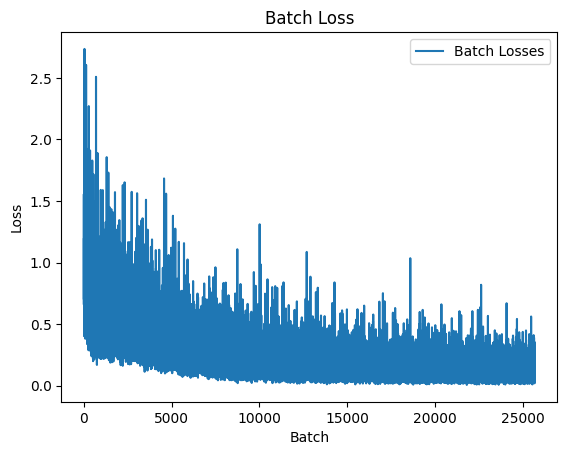

In [25]:
if train:
    df_data = pd.DataFrame({'Batch Losses': trainer.batch_losses})

    sns.lineplot(data=df_data)
    plt.xlabel('Batch')
    plt.ylabel('Loss')
    plt.title('Batch Loss')
    plt.show()

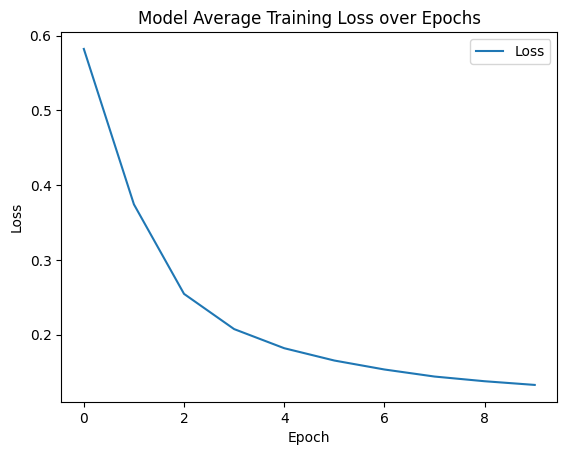

In [26]:
if train:
    df_data = pd.DataFrame({'Loss': trainer.epoch_losses})

    sns.lineplot(data=df_data)
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Model Average Training Loss over Epochs')
    plt.show()

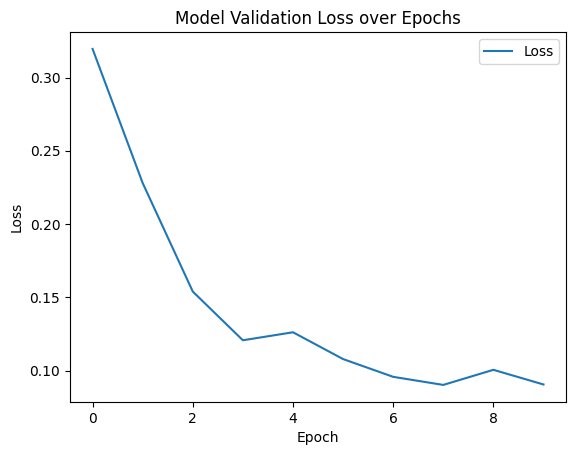

In [27]:
if train:
    df_data = pd.DataFrame({'Loss': trainer.validation_losses})

    sns.lineplot(data=df_data)
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Model Validation Loss over Epochs')
    plt.show()

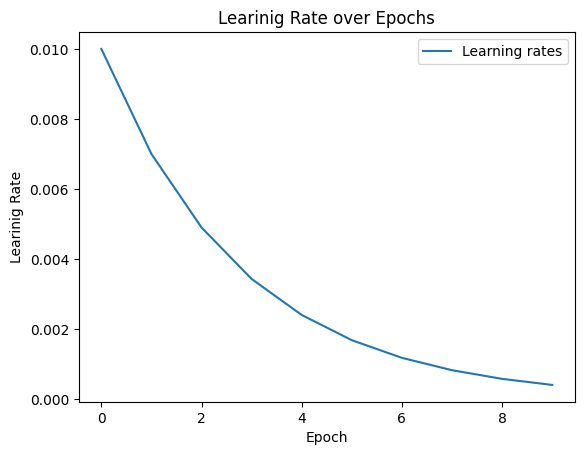

In [28]:
if train:
    df_data = pd.DataFrame({'Learning rates': trainer.learning_rates})

    sns.lineplot(data=df_data)
    plt.xlabel('Epoch')
    plt.ylabel('Learinig Rate')
    plt.title('Learinig Rate over Epochs')
    plt.show()

# Find Optimal Threshold

In [29]:
class DiceThresholdTester:
    
    def __init__(self, model: nn.Module, data_loader: torch.utils.data.DataLoader):
        self.model = model
        self.data_loader = data_loader
        self.cumulative_mask_pred = []
        self.cumulative_mask_true = []
        
    def precalculate_prediction(self) -> None:
        sigmoid = nn.Sigmoid()
        
        for images, mask_true in self.data_loader:
            if torch.cuda.is_available():
                images = images.cuda()

            mask_pred = sigmoid(model.forward(images))

            self.cumulative_mask_pred.append(mask_pred.cpu().detach().numpy())
            self.cumulative_mask_true.append(mask_true.cpu().detach().numpy())
            
        self.cumulative_mask_pred = np.concatenate(self.cumulative_mask_pred, axis=0)
        self.cumulative_mask_true = np.concatenate(self.cumulative_mask_true, axis=0)

        self.cumulative_mask_pred = torch.flatten(torch.from_numpy(self.cumulative_mask_pred))
        self.cumulative_mask_true = torch.flatten(torch.from_numpy(self.cumulative_mask_true))
    
    def test_threshold(self, threshold: float) -> float:
        _dice = Dice(use_sigmoid=False)
        after_threshold = np.zeros(self.cumulative_mask_pred.shape)
        after_threshold[self.cumulative_mask_pred[:] > threshold] = 1
        after_threshold[self.cumulative_mask_pred[:] < threshold] = 0
        after_threshold = torch.flatten(torch.from_numpy(after_threshold))
        return _dice(self.cumulative_mask_true, after_threshold).item()

In [30]:
dice_threshold_tester = DiceThresholdTester(model, data_loader_validation)
dice_threshold_tester.precalculate_prediction()

In [31]:
thresholds_to_test = [round(x * 0.01, 2) for x in range(101)]

optim_threshold = 0.975
best_dice_score = -1

thresholds = []
dice_scores = []

for t in thresholds_to_test:
    dice_score = dice_threshold_tester.test_threshold(t)
    if dice_score > best_dice_score:
        best_dice_score = dice_score
        optim_threshold = t
    
    thresholds.append(t)
    dice_scores.append(dice_score)
    
print(f'Best Threshold: {optim_threshold} with dice: {best_dice_score}')
df_threshold_data = pd.DataFrame({'Threshold': thresholds, 'Dice Score': dice_scores})

Best Threshold: 0.97 with dice: 0.5169292175889426


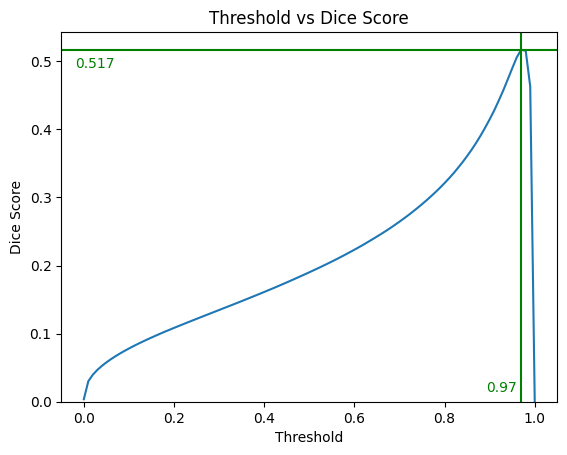

In [32]:
sns.lineplot(data=df_threshold_data, x='Threshold', y='Dice Score')
plt.axhline(y=best_dice_score, color='green')
plt.axvline(x=optim_threshold, color='green')
plt.text(-0.02, best_dice_score * 0.96, f'{best_dice_score:.3f}', va='center', ha='left', color='green')
plt.text(optim_threshold - 0.01, 0.02, f'{optim_threshold}', va='center', ha='right', color='green')
plt.ylim(bottom=0)
plt.title('Threshold vs Dice Score')
plt.show()

# Preview Models Predictions on Validation

Saved plot: plot_output/batch_1_img_1.png


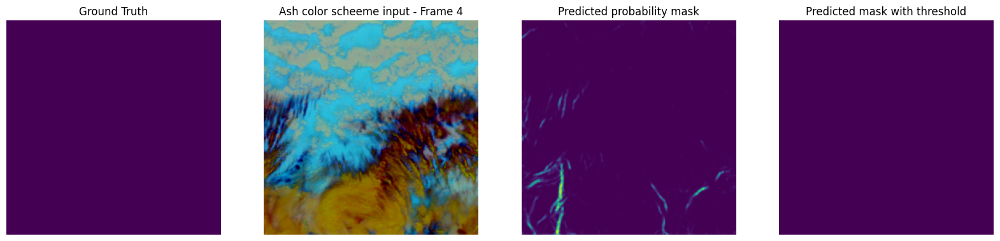

Saved plot: plot_output/batch_1_img_2.png


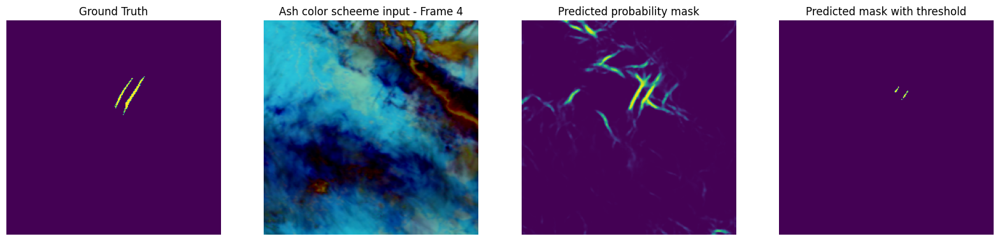

Saved plot: plot_output/batch_1_img_3.png


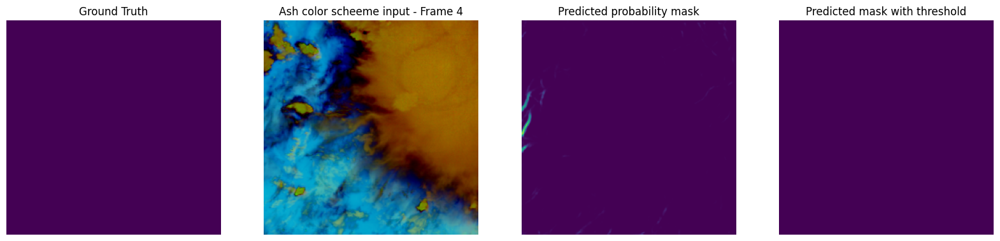

Saved plot: plot_output/batch_1_img_4.png


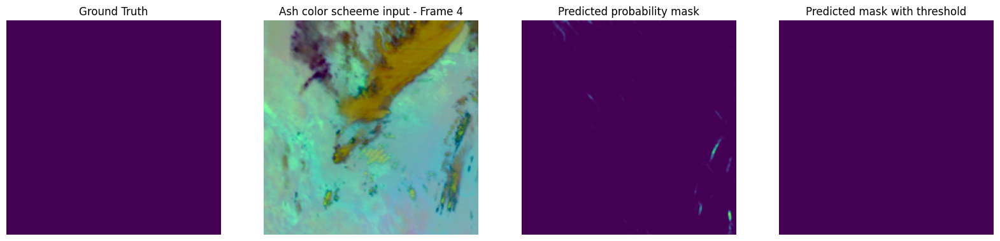

Saved plot: plot_output/batch_1_img_5.png


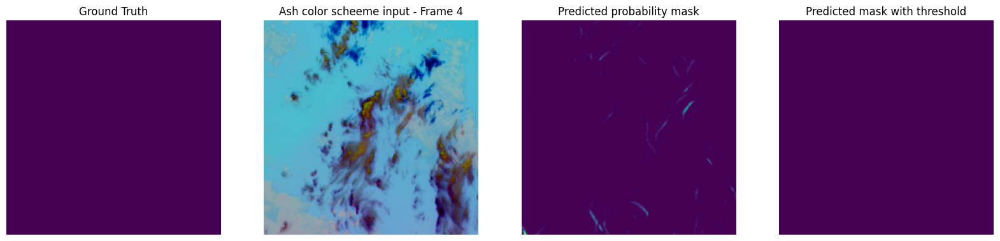

Saved plot: plot_output/batch_1_img_6.png


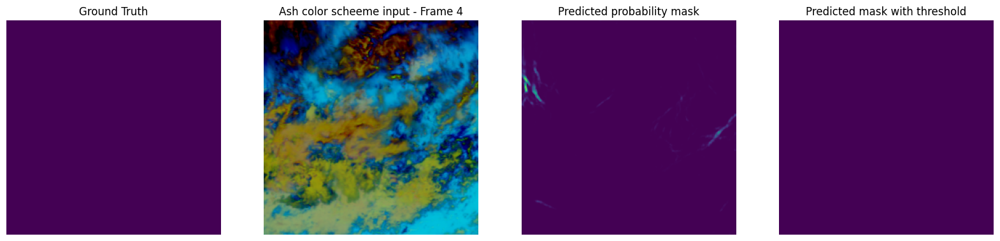

Saved plot: plot_output/batch_1_img_7.png


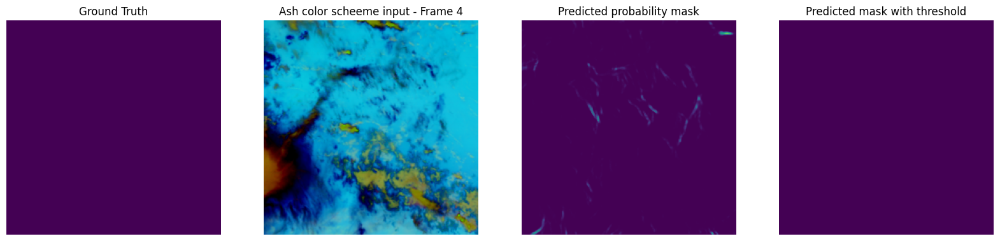

Saved plot: plot_output/batch_1_img_8.png


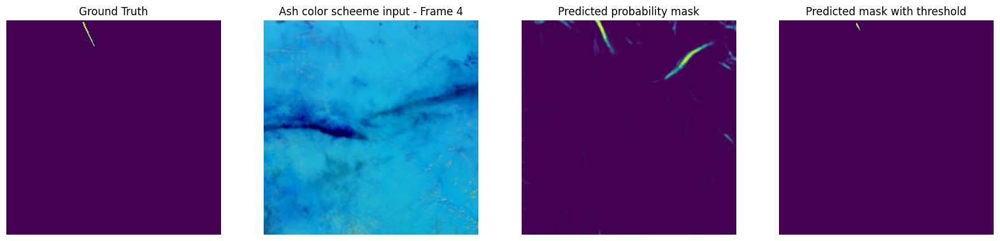

Saved plot: plot_output/batch_2_img_1.png


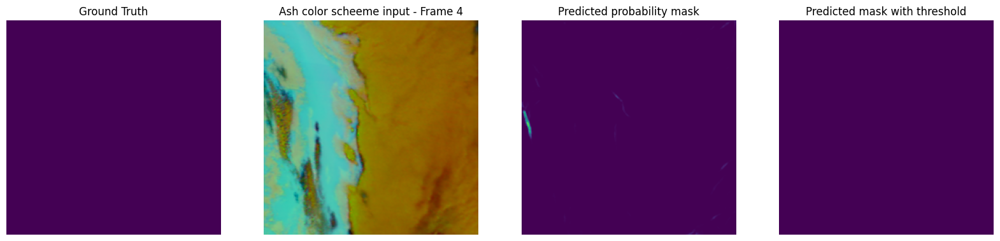

Saved plot: plot_output/batch_2_img_2.png


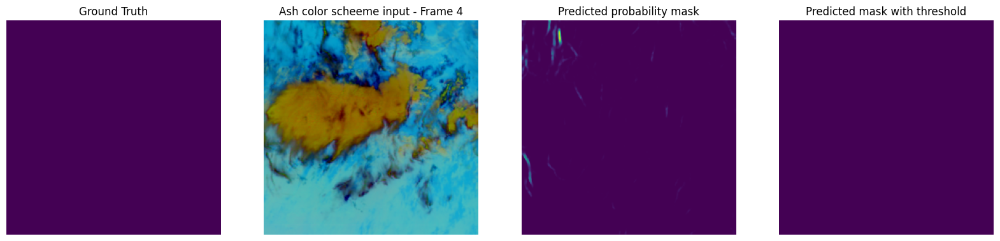

Saved plot: plot_output/batch_2_img_3.png


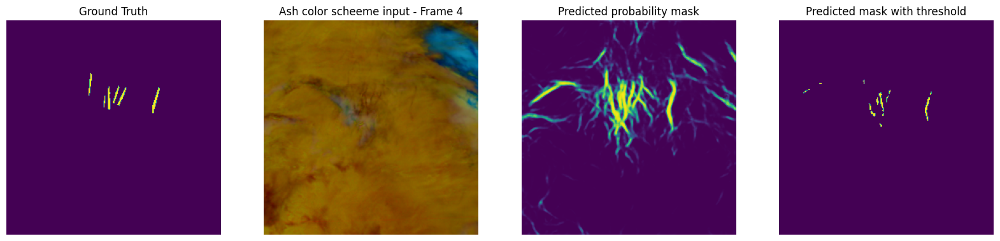

Saved plot: plot_output/batch_2_img_4.png


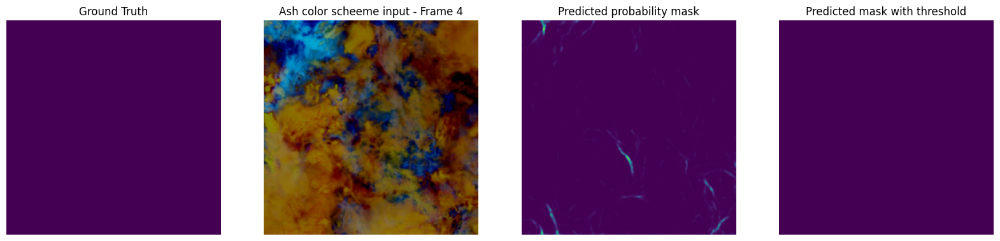

Saved plot: plot_output/batch_2_img_5.png


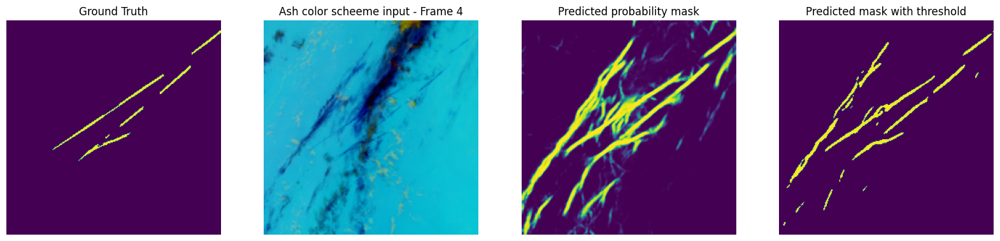

Saved plot: plot_output/batch_2_img_6.png


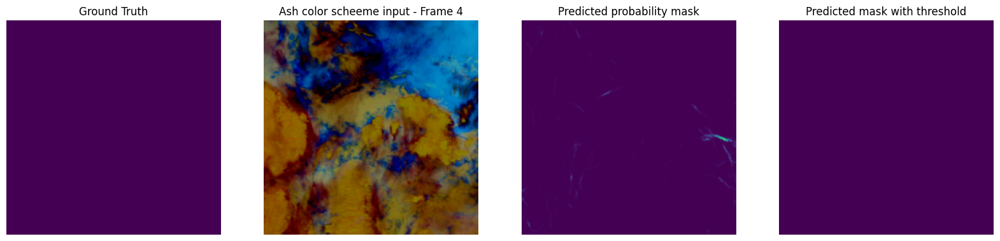

Saved plot: plot_output/batch_2_img_7.png


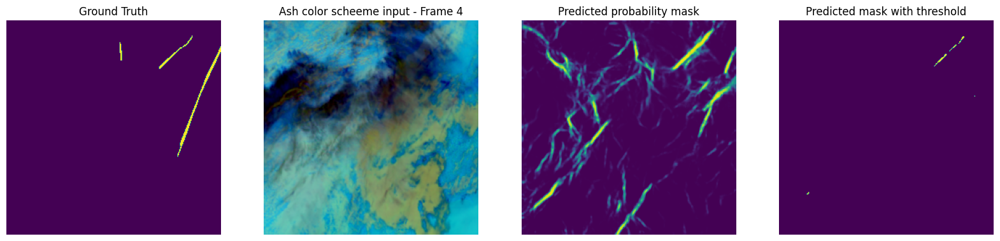

Saved plot: plot_output/batch_2_img_8.png


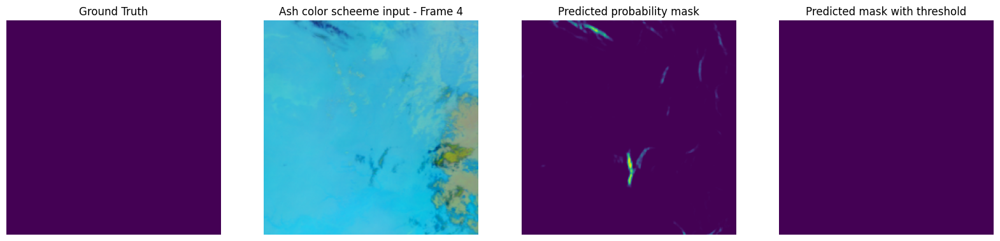

Saved plot: plot_output/batch_3_img_1.png


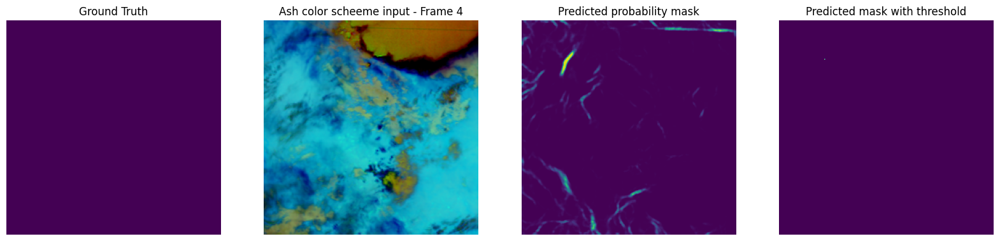

Saved plot: plot_output/batch_3_img_2.png


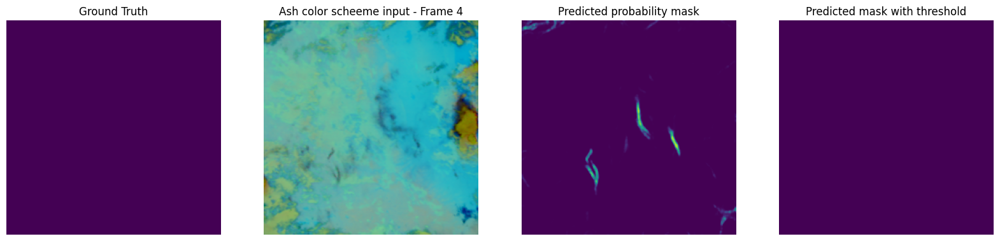

Saved plot: plot_output/batch_3_img_3.png


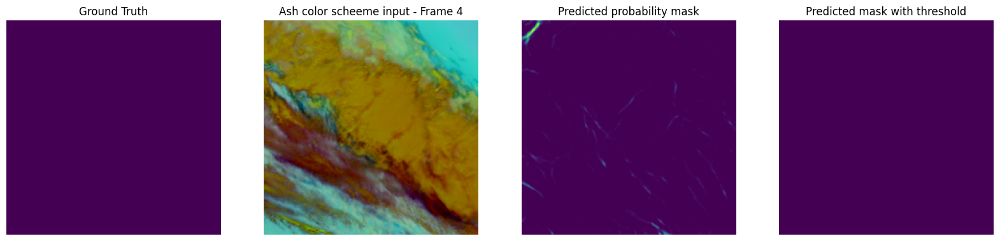

Saved plot: plot_output/batch_3_img_4.png


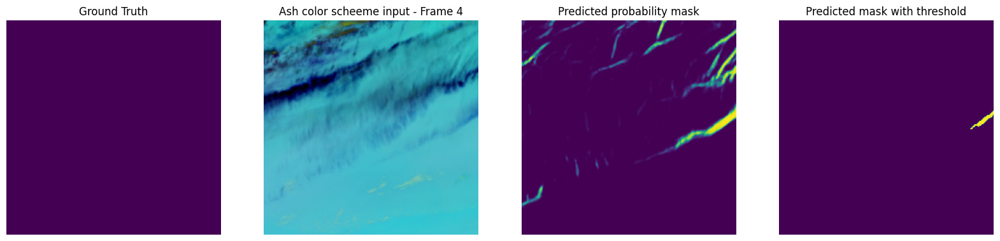

Saved plot: plot_output/batch_3_img_5.png


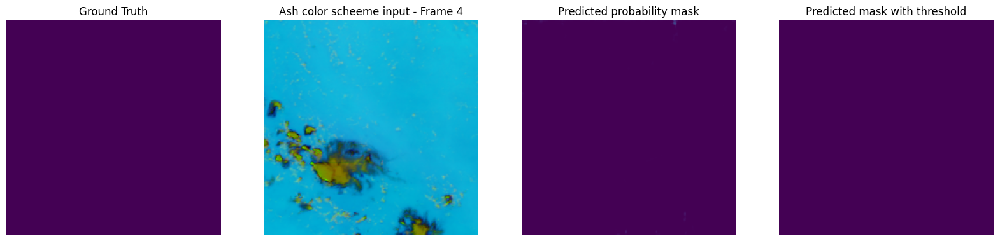

Saved plot: plot_output/batch_3_img_6.png


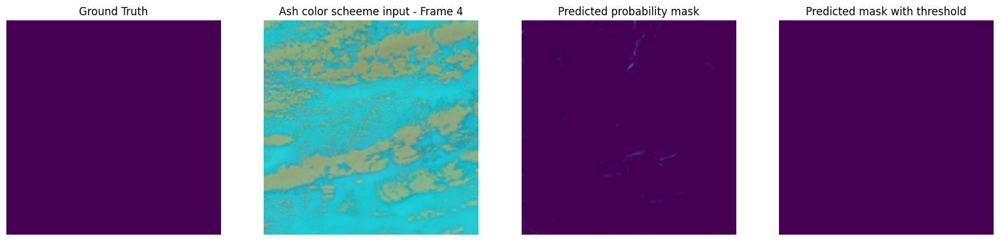

Saved plot: plot_output/batch_3_img_7.png


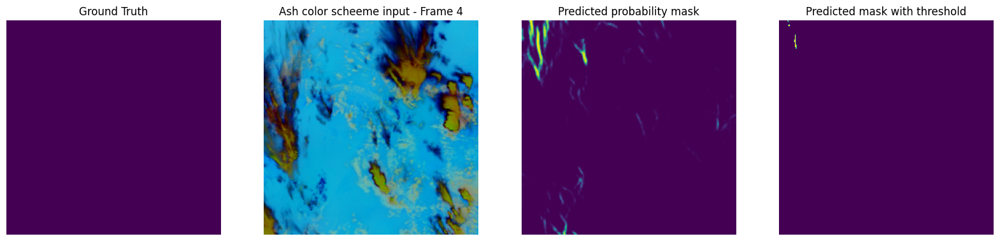

Saved plot: plot_output/batch_3_img_8.png


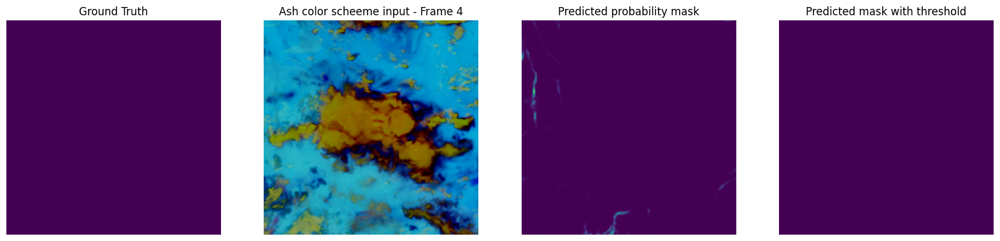

Saved plot: plot_output/batch_4_img_1.png


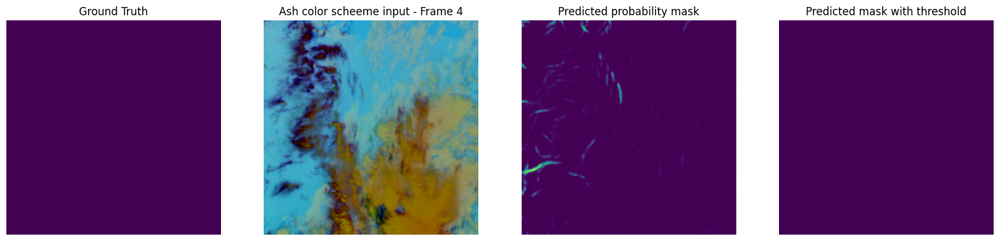

Saved plot: plot_output/batch_4_img_2.png


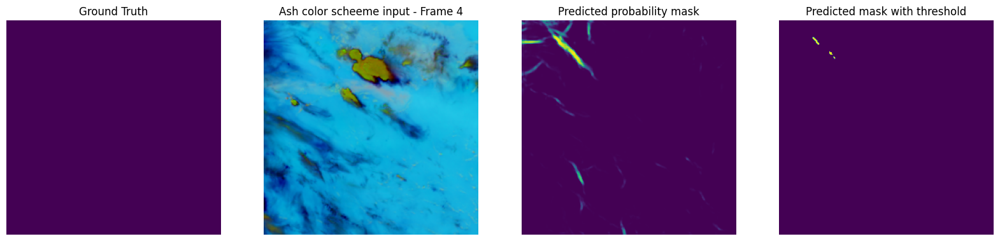

Saved plot: plot_output/batch_4_img_3.png


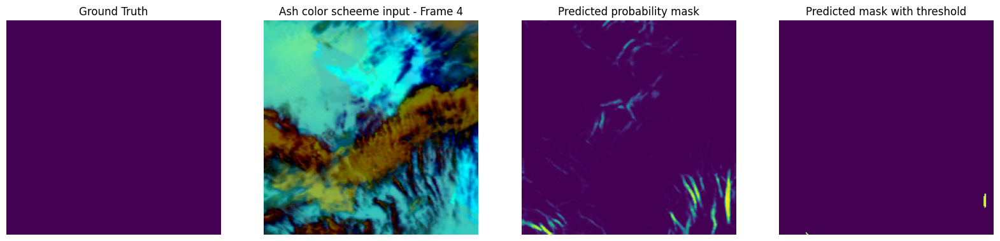

Saved plot: plot_output/batch_4_img_4.png


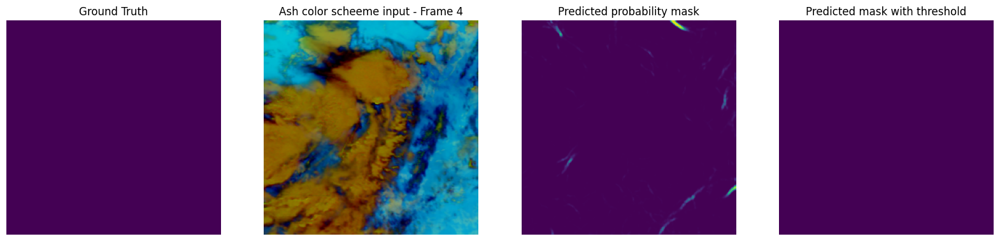

Saved plot: plot_output/batch_4_img_5.png


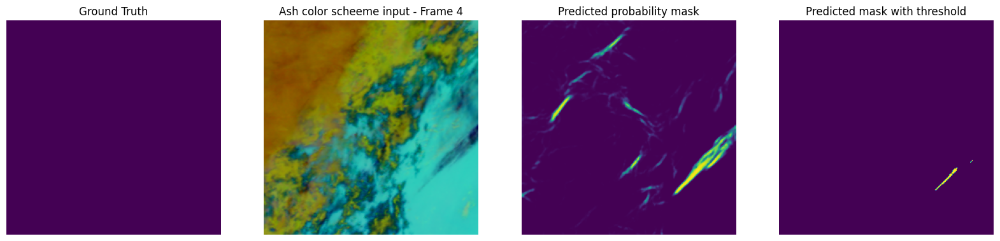

Saved plot: plot_output/batch_4_img_6.png


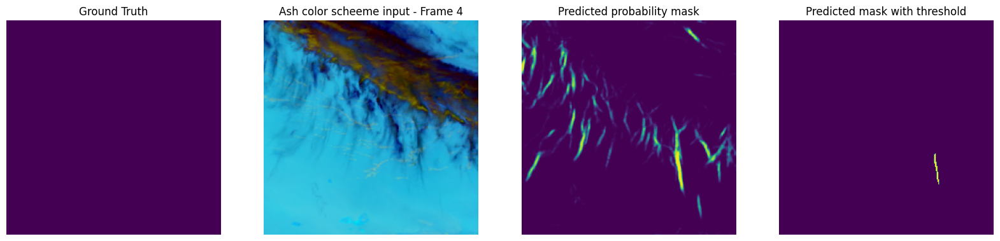

Saved plot: plot_output/batch_4_img_7.png


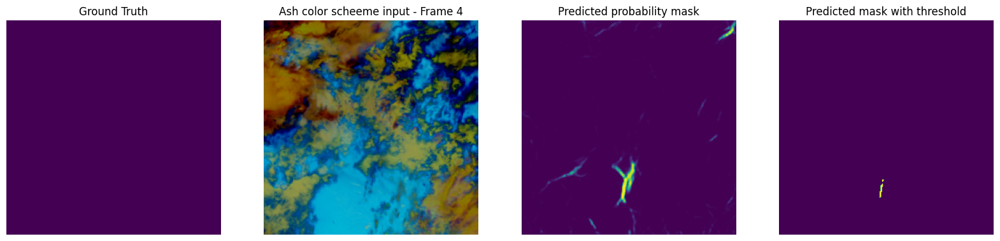

Saved plot: plot_output/batch_4_img_8.png


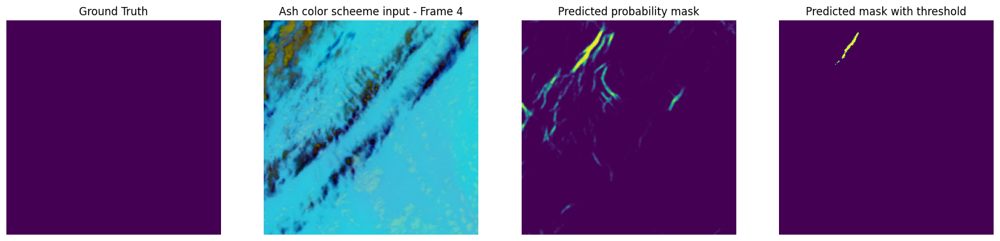

In [33]:
def sigmoid(x):
    return 1 / (1 + np.exp(-x))

batches_to_show = 4
model.eval()

for i, data in enumerate(data_loader_validation):
    images, mask = data
    
    # Predict mask for this instance
    if torch.cuda.is_available():
        images = images.cuda()
    predicated_mask = sigmoid(model.forward(images[:, :, :, :]).cpu().detach().numpy())
    
    # Apply threshold
    predicated_mask_with_threshold = np.zeros((images.shape[0], 256, 256))
    predicated_mask_with_threshold[predicated_mask[:, 0, :, :] < optim_threshold] = 0
    predicated_mask_with_threshold[predicated_mask[:, 0, :, :] > optim_threshold] = 1
    
    images = images.cpu()
        
    for img_num in range(0, images.shape[0]):
        fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(20,10))
        axes = axes.flatten()
        
        # Show groud trought 
        axes[0].imshow(mask[img_num, 0, :, :])
        axes[0].axis('off')
        axes[0].set_title('Ground Truth')
        
        # Show ash color scheme input image
        axes[1].imshow( np.concatenate(
            (
            np.expand_dims(images[img_num, 4, :, :], axis=2),
            np.expand_dims(images[img_num, 12, :, :], axis=2),
            np.expand_dims(images[img_num, 20, :, :], axis=2)
        ), axis=2))
        axes[1].axis('off')
        axes[1].set_title('Ash color scheeme input - Frame 4')

        # Show predicted mask
        axes[2].imshow(predicated_mask[img_num, 0, :, :], vmin=0, vmax=1)
        axes[2].axis('off')
        axes[2].set_title('Predicted probability mask')

        # Show predicted mask after threshold
        axes[3].imshow(predicated_mask_with_threshold[img_num, :, :])
        axes[3].axis('off')
        axes[3].set_title('Predicted mask with threshold')

        output_dir = "plot_output"
        os.makedirs(output_dir, exist_ok=True)

        # Save the plot
        plot_filename = os.path.join(output_dir, f"batch_{i+1}_img_{img_num+1}.png")
        plt.savefig(plot_filename)
        print(f"Saved plot: {plot_filename}")        
        
        plt.show()
    
    if i + 1 >= batches_to_show:
        break